# Endometriosis - Clustering
# Epithelial Cells - all datasets

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata
import os
import sys

def MovePlots(plotpattern, subplotdir):
    os.system('mkdir -p '+str(sc.settings.figdir)+'/'+subplotdir)
    os.system('mv '+str(sc.settings.figdir)+'/*'+plotpattern+'** '+str(sc.settings.figdir)+'/'+subplotdir)

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.figdir = './figures/cells/epithelial/'
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures

sys.executable

'/home/jovyan/my-conda-envs/sc_analysis/bin/python'

## Load data

In [2]:
path2datas = '/nfs/team292/lg18/endometriosis/integrated_objects/'
adata = sc.read(path2datas+'cells_epithelial_CLEAN_integrated.h5ad')
adata.X.shape

(91232, 17736)

## Add sample metadata

In [3]:
meta_sample = pd.read_csv('metadata-libraries_deconvoluted.csv',index_col=1)
meta_sample


annot = meta_sample['Biopsy_type'].to_dict()
adata.obs['Biopsy_type'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Biopsy_type'].value_counts())

annot = meta_sample['Tissue_sampled'].to_dict()
adata.obs['Tissue_sampled'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Tissue_sampled'].value_counts())

annot = meta_sample['Group'].to_dict()
adata.obs['Group'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Group'].value_counts())

annot = meta_sample['Spatial_location'].to_dict()
adata.obs['Spatial_location'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Spatial_location'].value_counts())

annot = meta_sample['Ectopic_group'].to_dict()
adata.obs['Ectopic_group'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Ectopic_group'].value_counts())

annot = meta_sample['BiopsyType_old'].to_dict()
adata.obs['BiopsyType_old'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['BiopsyType_old'].value_counts())

annot = meta_sample['Tissue'].to_dict()
adata.obs['Tissue'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Tissue'].value_counts())

annot = meta_sample['Treatment'].to_dict()
adata.obs['Treatment'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Treatment'].value_counts())

annot = meta_sample['10x kit'].to_dict()
adata.obs['10x kit'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['10x kit'].value_counts())


annot = meta_sample['Processing'].to_dict()
adata.obs['Processing'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Processing'].value_counts())

Superficial_Eutopic    89706
Whole_Uterus            1526
Name: Biopsy_type, dtype: int64
eutopic_endometrium    91232
Name: Tissue_sampled, dtype: int64
Ctrl_Superficial     56007
Endo_Superficial     33699
Ctrl_whole_uterus     1526
Name: Group, dtype: int64
Series([], Name: Spatial_location, dtype: int64)
Series([], Name: Ectopic_group, dtype: int64)
Superficial    89706
Organ_Donor     1526
Name: BiopsyType_old, dtype: int64
None         74644
EN_enrich     1526
EN             695
Name: Tissue, dtype: int64
Coll.+Trypsin       35009
Trypsin             21409
Collagenase         19752
ColdDig_LiveSort    14367
Name: Treatment, dtype: int64
3' v3.1    55501
3' v3.2    17685
3' v3      14367
3' v3.0     2984
3'           695
Name: 10x kit, dtype: int64
Fresh     71424
Frozen    19808
Name: Processing, dtype: int64


## Add donor metadata

In [4]:
meta_donors = pd.read_csv('metadata-donors.csv',index_col=None)
meta_donors = meta_donors.set_index('Donor')
meta_donors

annot = meta_donors['Endometrial pathology_A-F-H-P'].to_dict()
adata.obs['Endometrial_pathology'] = adata.obs.genotype.map(annot)
set(adata.obs['Endometrial_pathology'])

annot = meta_donors['Endometriosis_stage'].to_dict()
adata.obs['Endometriosis_stage'] = adata.obs.genotype.map(annot)
set(adata.obs['Endometriosis_stage'])

annot = meta_donors['Ectopic_EcP_EcO_EcPA_EcP-D'].to_dict()
adata.obs['Ectopic_EcP_EcO_EcPA_EcP-D'] = adata.obs.genotype.map(annot)
set(adata.obs['Ectopic_EcP_EcO_EcPA_EcP-D'])

annot = meta_donors['Peritoneal_Ovarian_DIE'].to_dict()
adata.obs['Peritoneal_Ovarian_DIE'] = adata.obs.genotype.map(annot)
set(adata.obs['Peritoneal_Ovarian_DIE'])

annot = meta_donors['Hormonal treatment'].to_dict()
adata.obs['Hormonal treatment'] = adata.obs.genotype.map(annot)
set(adata.obs['Hormonal treatment'])

annot = meta_donors['Age'].to_dict()
adata.obs['Age'] = adata.obs.genotype.map(annot)
set(adata.obs['Age'])

annot = meta_donors['Location'].to_dict()
adata.obs['Location'] = adata.obs.genotype.map(annot)
set(adata.obs['Location'])

annot = meta_donors['Binary Stage'].to_dict()
adata.obs['Binary Stage'] = adata.obs.genotype.map(annot)
print(adata.obs['Binary Stage'].value_counts())

annot = meta_donors['Stage'].to_dict()
adata.obs['Stage'] = adata.obs.genotype.map(annot)
adata.obs['Stage'].value_counts()

Secretory                 53046
Proliferative             21582
Hormones                  16286
Menstrual                   267
PeriMenopause_Hormones       51
Name: Binary Stage, dtype: int64


Secretory Early-Mid               20890
Secretory Mid                     16205
Secretory Early                   13211
Proliferative                     12476
Hormones                           6629
Proliferative Early                5781
Hormones (Proliferative Early)     4519
Hormones (Secretory Early)         2808
Secretory Late                     2486
Proliferative Late                 2439
Hormones (Inactive)                1706
Proliferative Disordered            886
Hormones Menstrual                  624
Menstrual                           267
Secretory                           254
Menopause_Hormones                   51
Name: Stage, dtype: int64

In [5]:
adata.write('/nfs/team292/lg18/endometriosis/integrated_objects/cells_epithelial_CLEAN_integrated.h5ad')

... storing 'Processing' as categorical
... storing 'Tissue' as categorical
... storing 'Treatment' as categorical
... storing '10x kit' as categorical
... storing 'Group' as categorical
... storing 'Endometriosis_stage' as categorical
... storing 'Peritoneal_Ovarian_DIE' as categorical
... storing 'Hormonal treatment' as categorical
... storing 'Location' as categorical
... storing 'Binary Stage' as categorical
... storing 'Stage' as categorical
... storing 'Ectopic_EcP_EcO_EcPA_EcP-D' as categorical
... storing 'Biopsy_type' as categorical
... storing 'Tissue_sampled' as categorical
... storing 'BiopsyType_old' as categorical
... storing 'Endometrial_pathology' as categorical
... storing 'Age' as categorical


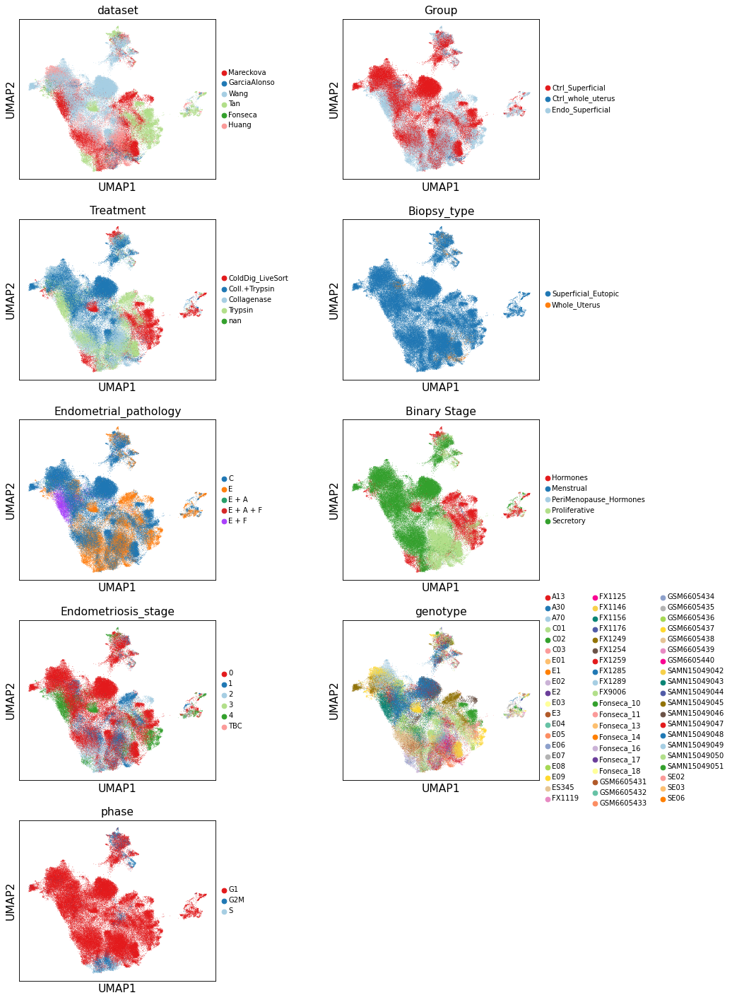

In [6]:
sc.pl.umap(adata, color=['dataset', 'Group', 'Treatment', 'Biopsy_type', 'Endometrial_pathology', 'Binary Stage', 'Endometriosis_stage', 'genotype', 'phase'], wspace=0.5, legend_fontsize=9, ncols=2, save='_allcells_metadata.pdf')

In [7]:
annot_df = pd.read_csv('/nfs/team292/lg18/endometriosis/annotations/cells_endometrium.csv',index_col=0)
annot_df.head()

annot = annot_df['Mareckova_celltype'].to_dict()
adata.obs['Mareckova_celltype'] = adata.obs_names.map(annot)
print(adata.obs['Mareckova_celltype'].value_counts())

annot_df = pd.read_csv('/nfs/team292/lg18/endometriosis/annotations/cells_endometrium_epithelial_CLEAN.csv',index_col=0)
annot_df.head()

annot = annot_df['Mareckova_epi_celltype'].to_dict()
adata.obs['Mareckova_epi_celltype'] = adata.obs_names.map(annot)
print(adata.obs['Mareckova_epi_celltype'].value_counts())

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3166: DtypeWarning: Columns (5,8,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,39,40,41,42,46,47,55,56,58,59,60,62,69) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


Epi_SOX9                23377
Epi_Glandular           21283
Epi_preGlandular        15398
Epi_Luminal             11248
Epi_Horm                10989
Epi_Ciliated             6312
Epi_endocervix_MUC5B     1491
Epi_Glands                761
Epi_cervix_KRT5           373
Name: Mareckova_celltype, dtype: int64
Hormones                    13287
Glandular                   13050
SOX9_functionalis_II        12583
preGlandular                11840
Luminal                     10250
Glandular_secretory          8610
Ciliated                     5236
Cycling                      4129
preLuminal                   2735
SOX9_luminal                 2700
SOX9_functionalis_I          1590
MUC5B                        1389
Hormones_secretory           1094
Glandular_secretory_FGF7      804
Doublet                       669
KRT5                          484
preCiliated                   427
SOX9_basalis_I                355
Name: Mareckova_epi_celltype, dtype: int64


... storing 'Mareckova_celltype' as categorical
... storing 'Mareckova_epi_celltype' as categorical


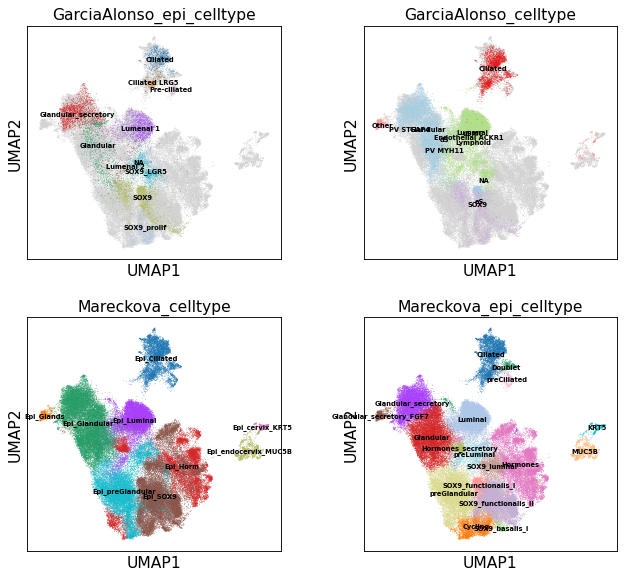

In [8]:
adata.obs['GarciaAlonso_epi_celltype'] = adata.obs['GarciaAlonso_epi_celltype'].replace('nan', np.NaN)
adata.obs['GarciaAlonso_celltype'] = adata.obs['GarciaAlonso_celltype'].replace('nan', np.NaN)
sc.pl.umap(adata, color=['GarciaAlonso_epi_celltype', 'GarciaAlonso_celltype', 'Mareckova_celltype', 'Mareckova_epi_celltype'], legend_loc='on data', ncols = 2, legend_fontsize=6)

### Visualize general markers

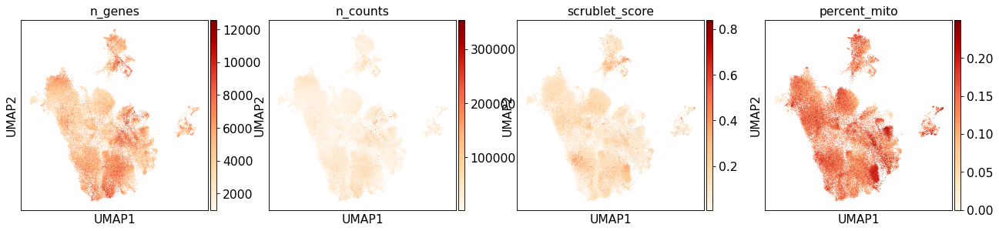

In [9]:
sc.pl.umap(adata, color=['n_genes','n_counts','scrublet_score', 'percent_mito'], color_map='OrRd')

In [10]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

normalizing by total count per cell
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
    finished (0:00:05): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


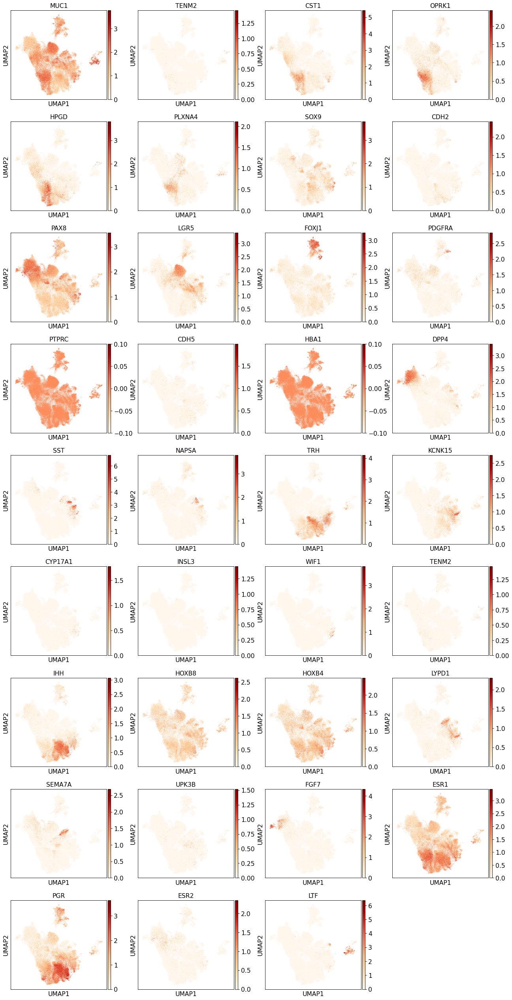

In [11]:
sc.pl.umap(adata, color=['MUC1', 'TENM2', 'CST1','OPRK1', 'HPGD', 'PLXNA4', "SOX9", 'CDH2', "PAX8", 'LGR5', 'FOXJ1',  "PDGFRA", 'PTPRC', 'CDH5', 'HBA1', 'DPP4', 'SST', 'NAPSA', 'TRH','KCNK15',
                        "CYP17A1", "INSL3", "WIF1", 'TENM2',  'IHH', 'HOXB8', 'HOXB4', 'LYPD1', 'SEMA7A', 'UPK3B', 'FGF7', 'ESR1', 'PGR', 'ESR2', 'LTF'], color_map='OrRd', use_raw=False )

In [12]:
# Add LR labeltransfer
meta_LR_invivoW = pd.read_csv('/nfs/team292/lg18/endometriosis/old/organoidsNatGen_LR_invivoWang.csv',index_col=0)
meta_LR_invivoW.head()

meta_LR_invivoM = pd.read_csv('/nfs/team292/lg18/endometriosis/old/organoidsNatGen_LR_invivoMareckova.csv',index_col=0)
meta_LR_invivoM.head()

annot = {**meta_LR_invivoW['predictions'].to_dict(), **meta_LR_invivoM['predictions'].to_dict()} 
adata.obs['invitro_predictions'] = adata.obs.index.map(annot)
print(adata.obs['invitro_predictions'].value_counts())

annot = {**meta_LR_invivoW['probabilities'].to_dict(), **meta_LR_invivoM['probabilities'].to_dict()} 
adata.obs['invitro_probabilities'] = adata.obs.index.map(annot)

NH_Day6             7741
NH_Day2             5859
Inflamatory         5682
Estrogen Induced    4271
Secretory           4073
Ciliated            2380
NH_Day0             1589
Name: invitro_predictions, dtype: int64


## Clustering the graph
As Seurat and many others, we use the leiden graph-clustering method (community detection based on optimizing modularity). It has been proposed for single-cell data by Levine et al. (2015).

In [13]:
sc.tl.leiden(adata, resolution=0.75)

running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:45)


... storing 'invitro_predictions' as categorical


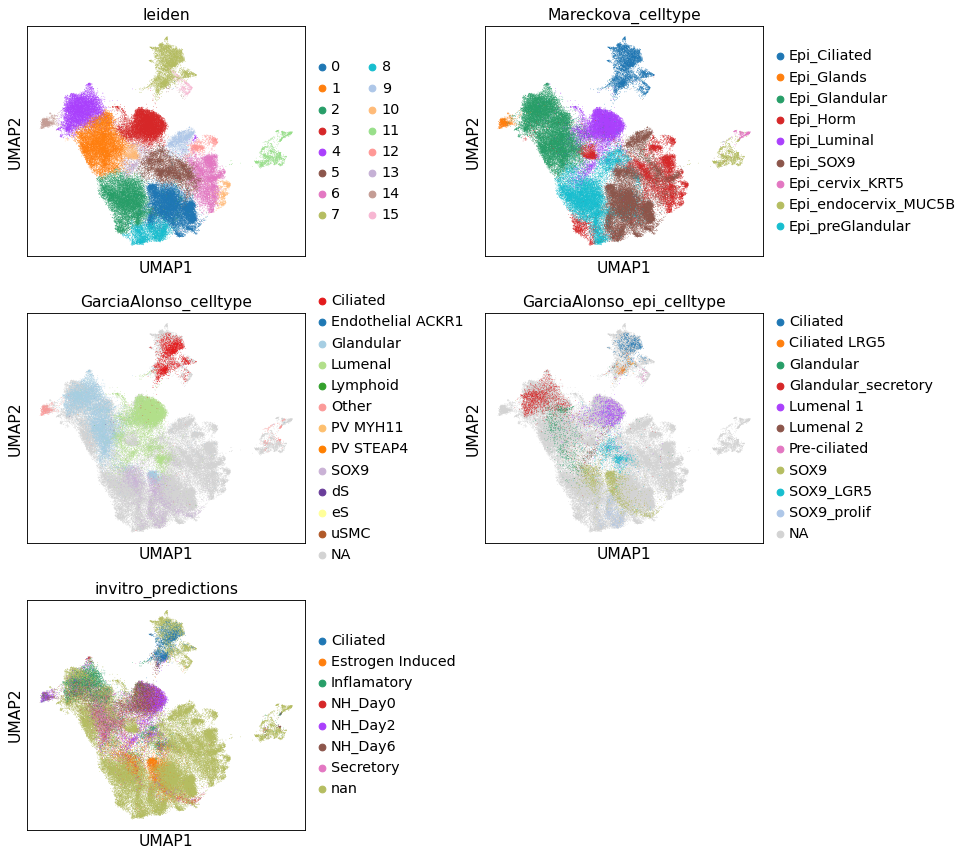

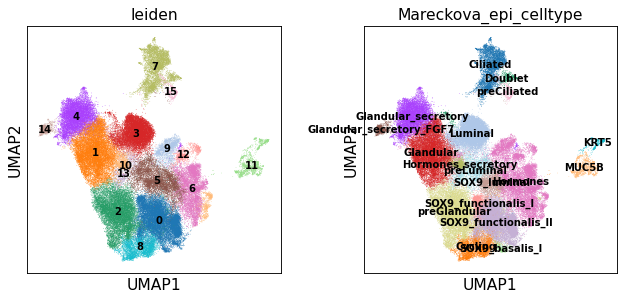

In [14]:
sc.pl.umap(adata, color=['leiden', 'Mareckova_celltype', 'GarciaAlonso_celltype', 'GarciaAlonso_epi_celltype', 'invitro_predictions'], wspace=0.5, ncols=2)
sc.pl.umap(adata, color=['leiden', 'Mareckova_epi_celltype'],legend_loc='on data', legend_fontsize=9)

running Leiden clustering
    finished: found 18 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


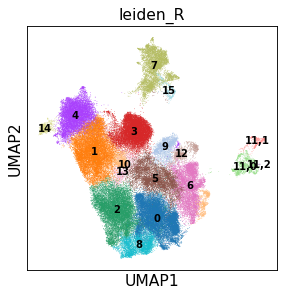

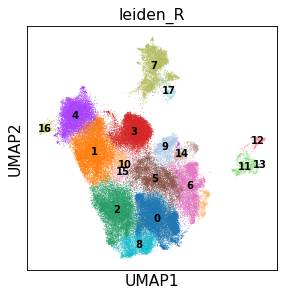

In [15]:
# recluster
sc.tl.leiden(adata, resolution=0.1, restrict_to=('leiden', ['11']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

running Leiden clustering
    finished: found 22 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:02)


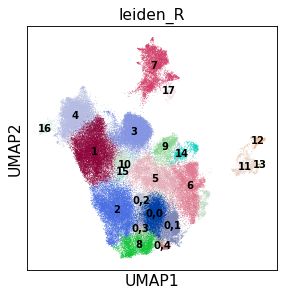

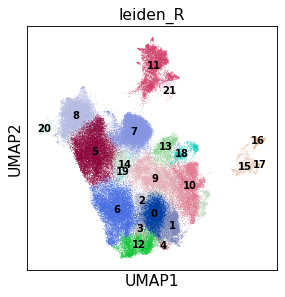

In [16]:
# recluster
sc.tl.leiden(adata, resolution=0.3, restrict_to=('leiden', ['0']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

running Leiden clustering
    finished: found 24 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


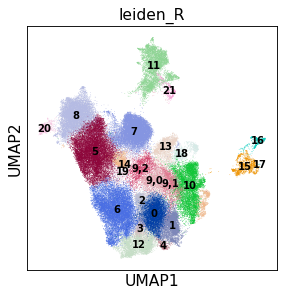

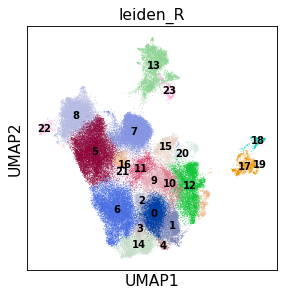

In [17]:
# recluster
sc.tl.leiden(adata, resolution=0.2, restrict_to=('leiden', ['9']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

running Leiden clustering
    finished: found 26 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


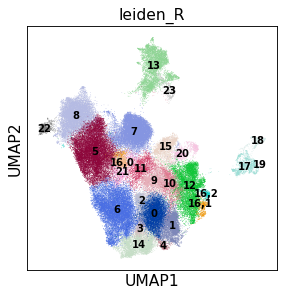

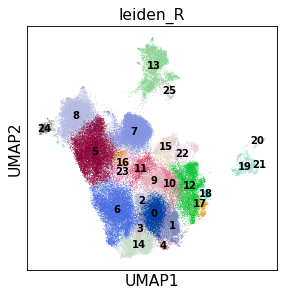

In [18]:
# recluster
sc.tl.leiden(adata, resolution=0.1, restrict_to=('leiden', ['16']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

running Leiden clustering
    finished: found 27 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


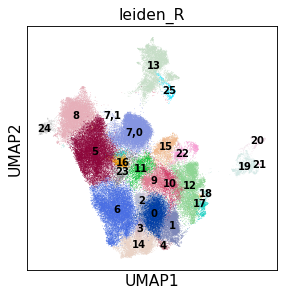

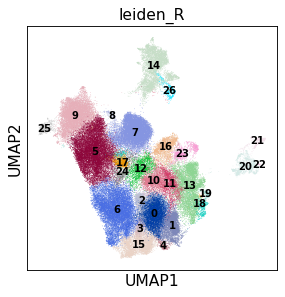

In [19]:
# recluster
sc.tl.leiden(adata, resolution=0.15, restrict_to=('leiden', ['7']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

running Leiden clustering
    finished: found 28 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:01)


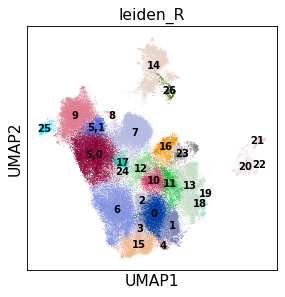

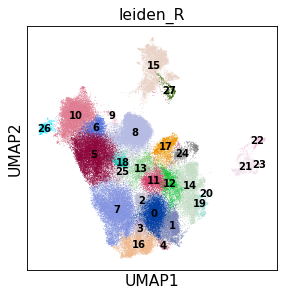

In [20]:
# recluster
sc.tl.leiden(adata, resolution=0.2, restrict_to=('leiden', ['5']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

running Leiden clustering
    finished: found 30 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


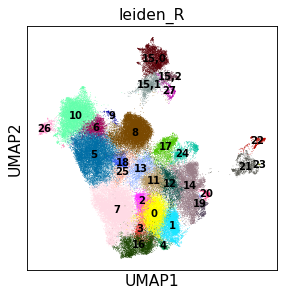

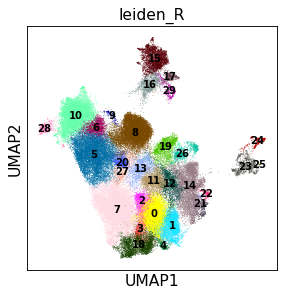

In [21]:
# recluster
sc.tl.leiden(adata, resolution=0.125, restrict_to=('leiden', ['15']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

### Check global trends

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


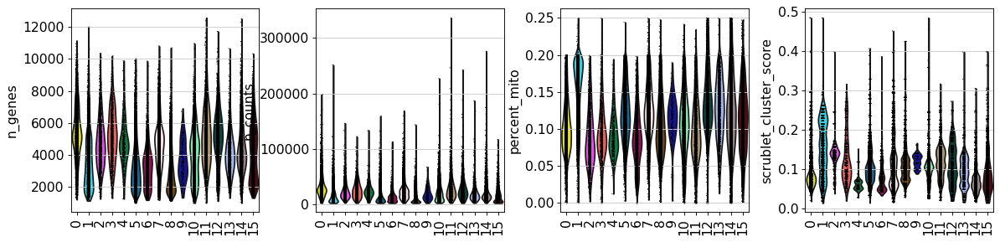

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


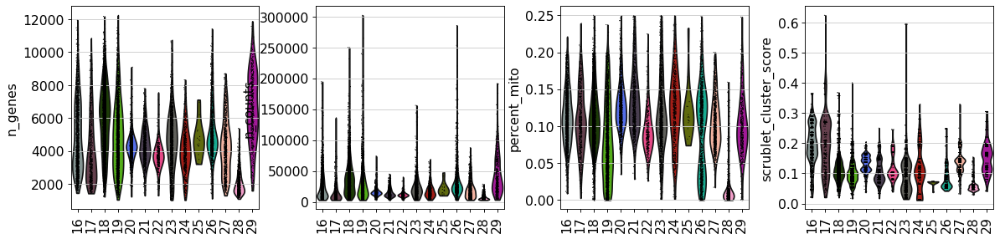

In [22]:
sc.pl.violin(adata[[ float(i) <= 15 for i in adata.obs.leiden ]], keys= ['n_genes', 'n_counts', 'percent_mito', 'scrublet_cluster_score'], groupby = 'leiden_R', rotation = 90)
sc.pl.violin(adata[[ float(i) > 15 for i in adata.obs.leiden ]], keys= ['n_genes', 'n_counts', 'percent_mito', 'scrublet_cluster_score'], groupby = 'leiden_R', rotation = 90)
# sc.pl.violin(adata, keys= ['percent_mito', 'scrublet_score', 'scrublet_cluster_score'], groupby = 'leiden_R', rotation = 90)

# Finding marker genes

Compute a ranking for the highly differential genes in each cluster. Here, we simply rank genes with a t test, which agrees quite well with Seurat.

## All vs rest

In [23]:
# # Compute Mann-Withney test with scanpy
# sc.tl.rank_genes_groups(adata, groupby='leiden', use_raw=False) #, method='logreg'
# # Plot
# sc.pl.rank_genes_groups_dotplot(adata, n_genes=20, dendrogram=False, save='_scanpy.pdf', standard_scale = 'var')

In [24]:
def Barplot(which_var, adata, var='lineage', height=3, color = False):
    plotdata = pd.crosstab(adata.obs[var], adata.obs[which_var], normalize='index') * 100
    if 'category' in plotdata.index.dtype.name:
        plotdata.index.reorder_categories(adata.obs[var].cat.categories[::-1])

    if not color:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False)
    else:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False, color = color)
    ax1.set_title(which_var+' %')
    ax1.set_ylabel(var)
    horiz_offset = 1
    vert_offset = 1.
    ax1 = ax1.legend(bbox_to_anchor = (horiz_offset, vert_offset))
    ax1.figure.savefig(str(sc.settings.figdir)+'/barplot_'+var+'_proportions_'+which_var+'.pdf', bbox_inches='tight',
                       dpi=300, orientation='landscape', format= 'pdf', optimize=True)

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning

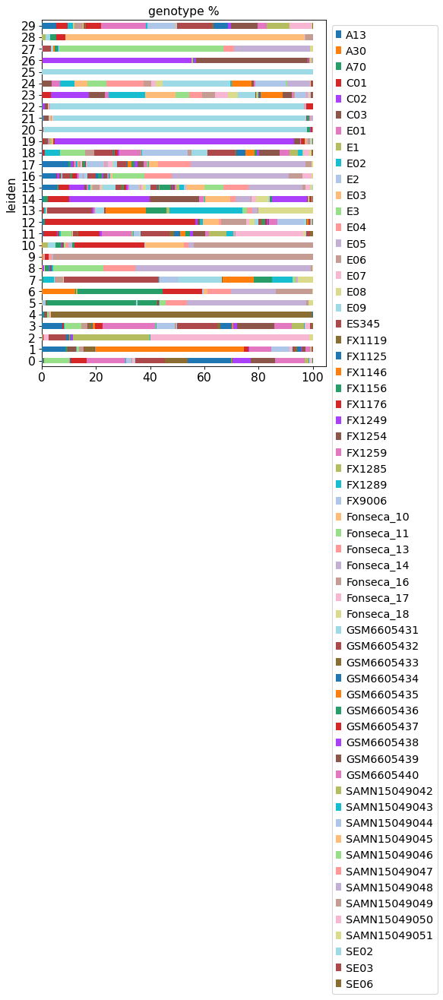

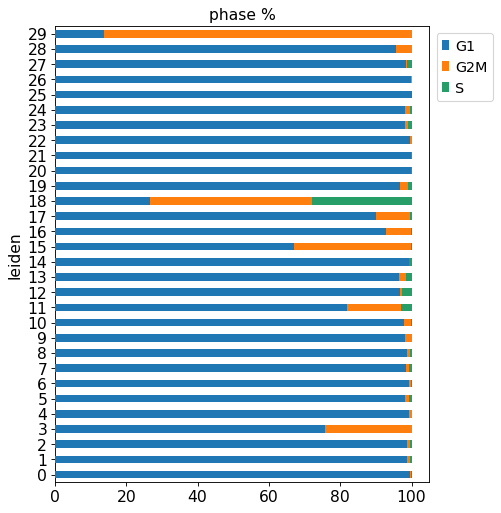

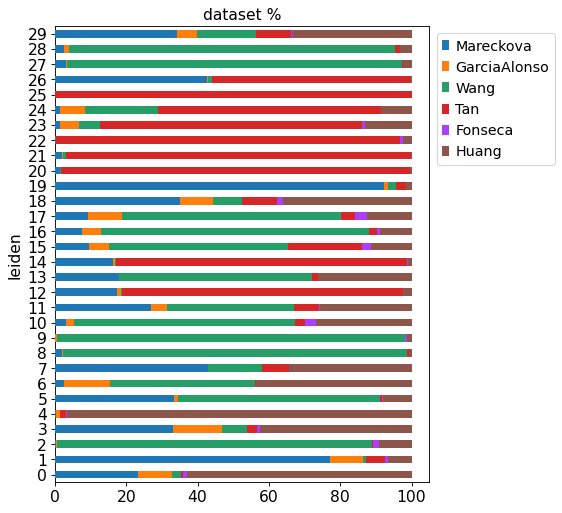

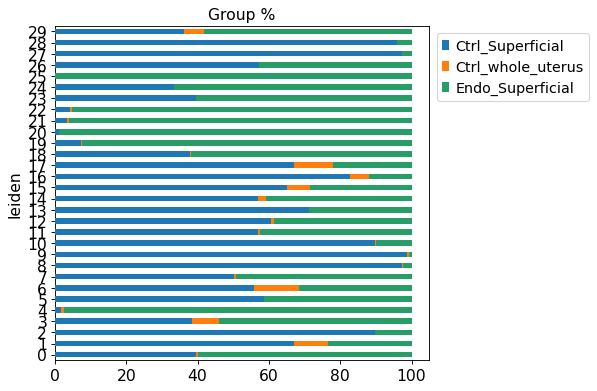

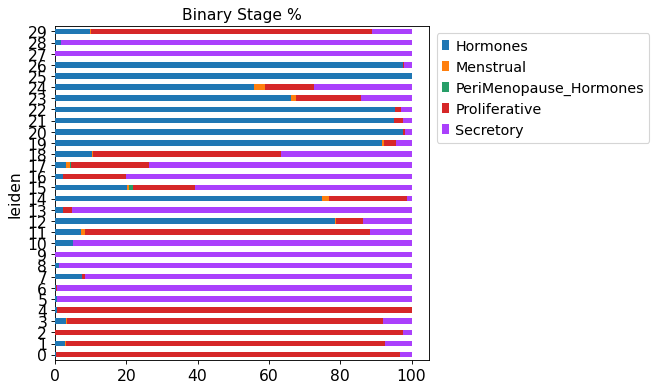

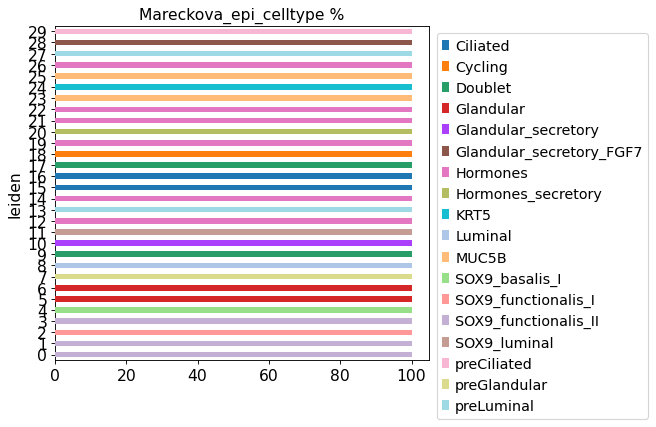

In [25]:
Barplot('genotype', adata, var='leiden', height=7.5)
Barplot('phase', adata, var='leiden', height=7.5)
Barplot('dataset', adata, var='leiden', height=7.5)
Barplot('Group', adata, var='leiden', height=5.5)
Barplot('Binary Stage', adata, var='leiden', height=5.5)
Barplot('Mareckova_epi_celltype', adata, var='leiden', height=5.5)



In [26]:
marker_genes = {
    'Epithelial lineage': {'EPCAM', 'PAX8'},
    'Follicular':{'MMP7'},
    'Luteal' :{'MT1M', 'MT1H', 'CRYAB'},
    'Proliferative':{'IHH', "SPDEF", "TRH", "EMID1", "KMO", 'OVGP1', 'ADAMTS6', 'SOX17'},
    'SOX9':{'SOX9'},
    'Progenitor SOX9+/CDH2+':{'CDH2', 'KLK11', 'AXIN2', 'ALDH1A1', 'FOXA2', 'FUT4', 'SLC7A11', 'PHLDA1'},
    'Prolif SOX9+':{'TRAF3IP3', 'BACH2', 'ZHX2', 'CCNA1', 'GLS', 'IGF2BP2',  'PLAU', 'CREB5'},
    'Prolif SOX9+/CDH2+':{'CDH2', 'PRDM1' ,'AREG', 'PHLDA1', 'SLC7A11', 'AQP3', 'DKK1'},
    'Prolif SOX9+/LGR5+':{'LGR5', 'WNT7A', 'TNF', 'CLDN22', 'CD109', 'EMILIN2', 'CXCL1', 'NRP1', 'B3GNT7', 'AKAP12'}, #'SEMA3A', 'NALCN'
    'P4-induced':{'SUFU', 'CBR3', 'TENM2', 'CST1','OPRK1', 'HPGD', 'PLXNA4', 'SLC16A1'},
    'Luminalal':{'SULT1E1',  'LEFTY1', 'PTGS2', 'RAB27B', 'PTGS1', 'LGR5', 'IL6', 'CDH16', 'BAALC', 'CLDN22'},
#     'Luminalal early':{'HEY1', 'ABCG1', 'CAPN6', 'CYP26A1', 'SPARCL1'},
    'Luminalal late':{'MYLK'},
    'pre-WOI' :{'MMP26'},
    'Glandular': {'SLC18A2', 'C2CD4A', 'SCGB2A2', 'GAST', 'S100P'}, # 'SSP1', 
    'Glandular secretory': {'DPP4', 'PAEP', 'COMP', 'TSPAN8', 'FGF7', 'FXYD2', 'PTPRR', 'TBXAS1'}, # 'SSP1',   
    'MUC5B+':{"MUC5B",  'PTGS2', "STRA6", "LTF"}, # , "BPIFB1"
    'KRT5/TP63':{'KRT5', 'TP63', 'SNCG'},
    'Ciliated Epithelial lineage': {'PIFO', 'FOXJ1', 'TP73'},
    'pre-Ciliated':{"MUC12", 'CDC20B', 'CCNO'},
#     'Ciliated LGR5+':{"LGR5"},
    'Inflamatory':{'SST'},
    'Mesenchymal lineage': {"PDGFRA", 'OGN','DCN', 'LUM'},
#     'Fibroblast C7': {'C7'},
    'eS':{'MMP11', 'CRABP2', 'ECM1'},
    'dS':{'DKK1', 'IL15', 'CFD'},
    'PV lineage':{'MYH11', 'ACTA2', "MCAM"},
    'Endothelial': {'PECAM1', 'VWF', 'CDH5'},
    'Immune': {'PTPRC'},
    'Lymphoid': {'CD3D', 'NCAM1' , 'NKG7'},
    'Myeloid': {'CSF1R', 'CD14'},
    'lowQC': {"HBA1", "HBA2"},
    'WIF1':{'WIF1', 'NKD1', 'NRN1', 'AZGP1'},
    'Hormones':{'KCNK15'},
#     'HOXBs':{'HOXB8', 'HOXB4', 'HOXB5', 'HOXB6'},
    'Receptors':{'PGR', 'ESR1'},
    'WNT effectors':{'AXIN1', 'AXIN2'},
    'Mesothelial': {"KLK11", 'UPK3B'}, #, 'LRRN4'
    'Prostaglandin R':{'PTGER4','PTGFR', 'PTGER3', 'PTGIR', 'PTGDR', 'PTGDR2', 'PTGER1', 'PTGER2'},
    'Prostaglandin S':{ 'PTGES', 'HPGDS', 'PTGS1', 'TBXAS1', 'PTGS2', 'PTGDS', 'PLA2G4A', 'PTGES3', 'PTGIS',  'PTGES2'}, # 'PRXL2B',
    'MMPs':{'MMP7','MMP11',  'MMP24', 'MMP26'},
#     'Granulosa': {"AMH", "GATA4", 'WNT6', 'GSTA1'},
#     'Theca': {"CYP17A1", "INSL3", 'PTCH2'}
#     'cycling': {'CDK1', 'MKI67', 'TOP2A'}
}

marker_genes_short = {
    'Epithelial lineage': {'EPCAM', 'PAX8'},    
    'MUC5B+':{"MUC5B",},
    'Mesenchymal': {"PDGFRA", 'COL1A1','DCN', 'LUM'}, # 'DCN', 'LUM'
    'PV':{'MYH11', 'ACTA2', "MCAM", 'RGS5'},
    'uSMCs':{'LEFTY2', 'ACTG2', 'ITGA11'},
    'Endothelial': {'PECAM1', 'VWF', 'CDH5'},
    'Immune': {'PTPRC'},
    'Lymphoid': {'CD3D', 'NCAM1' , 'NKG7'},
    'Myeloid': {'CSF1R', 'CD14'},
    'Erythroid': {"HBB", "HBA1"}
}

Epithelial lineage


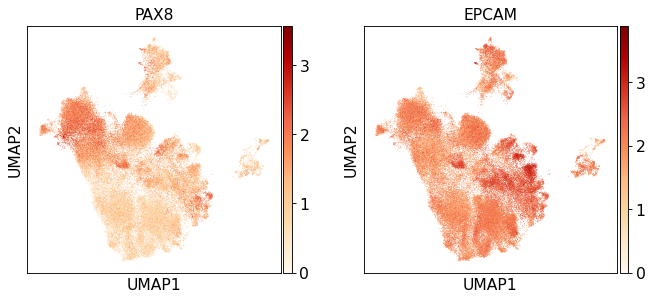

Follicular


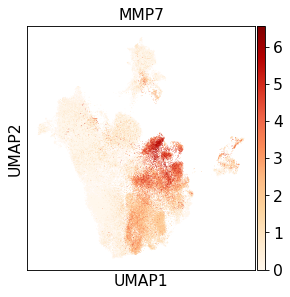

Luteal


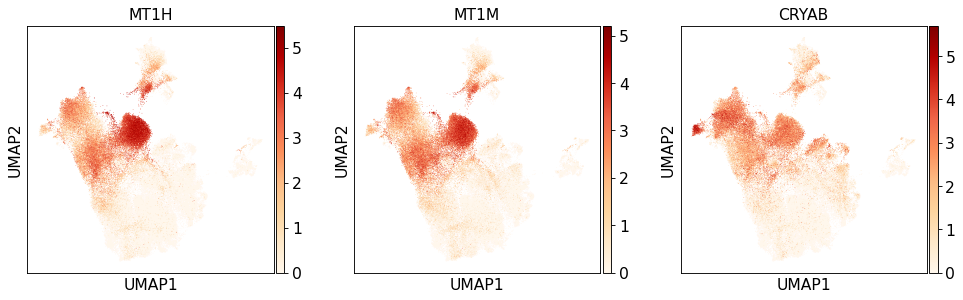

Proliferative


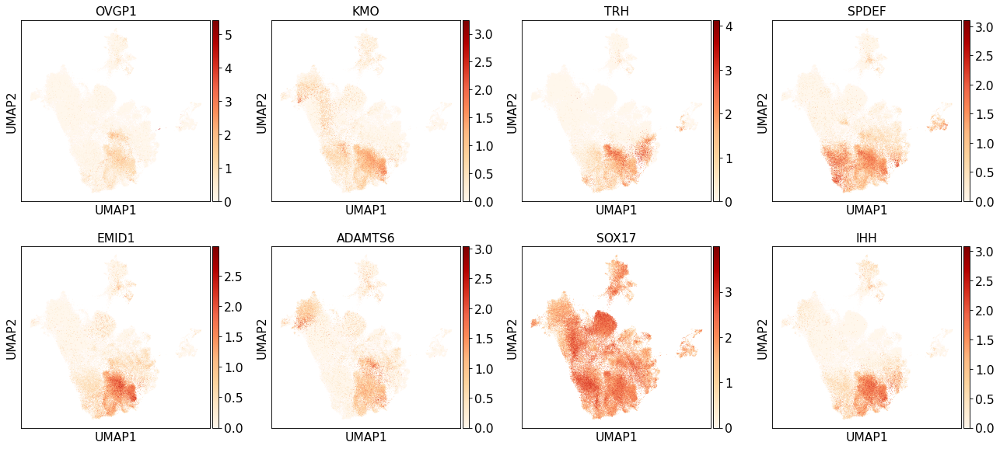

SOX9


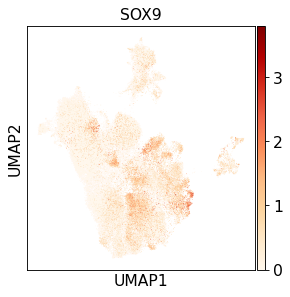

Progenitor SOX9+/CDH2+


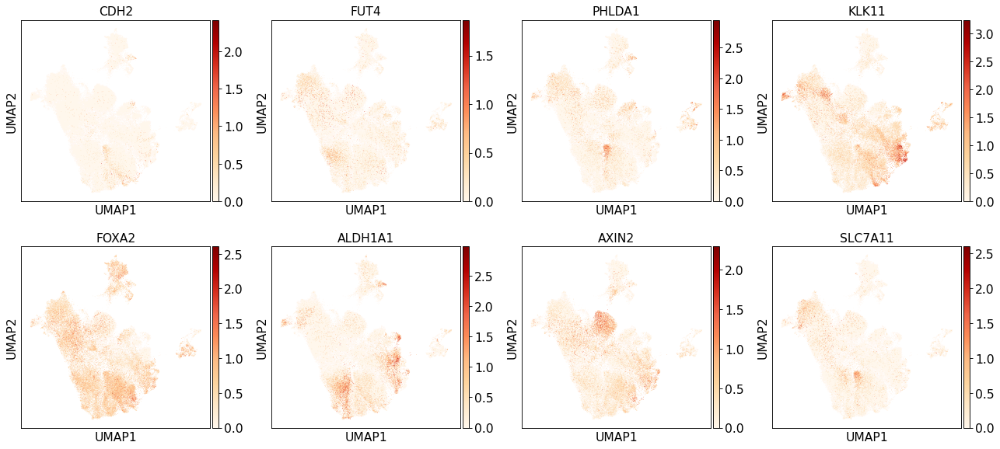

Prolif SOX9+


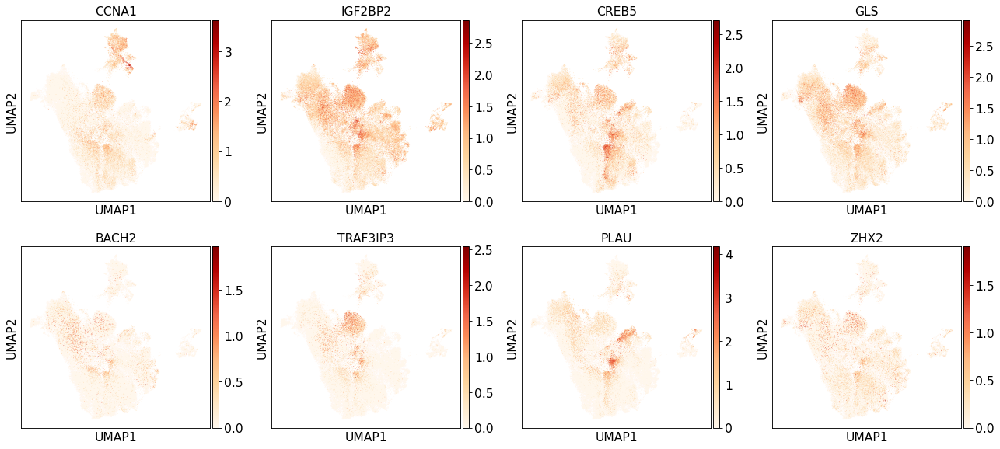

Prolif SOX9+/CDH2+


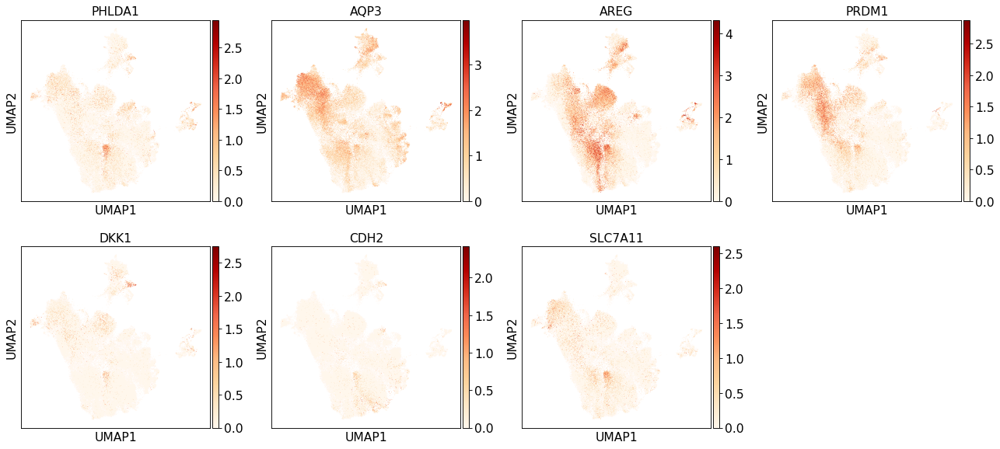

Prolif SOX9+/LGR5+


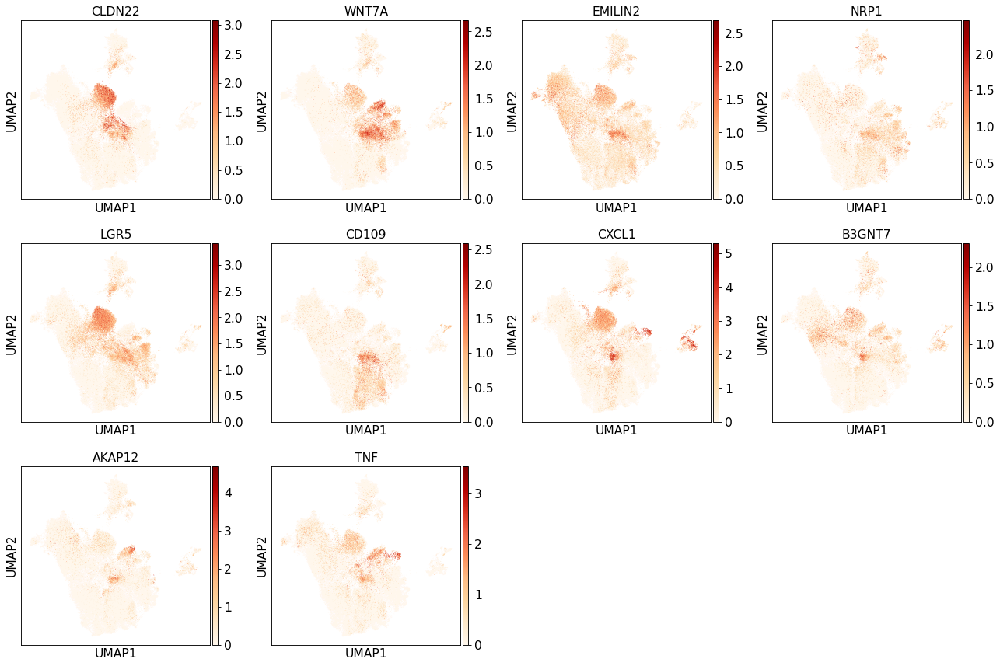

P4-induced


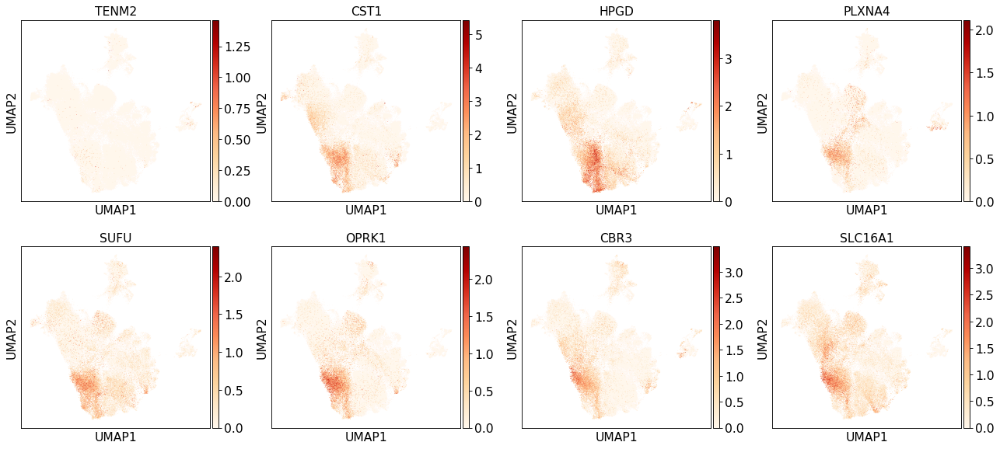

Luminalal


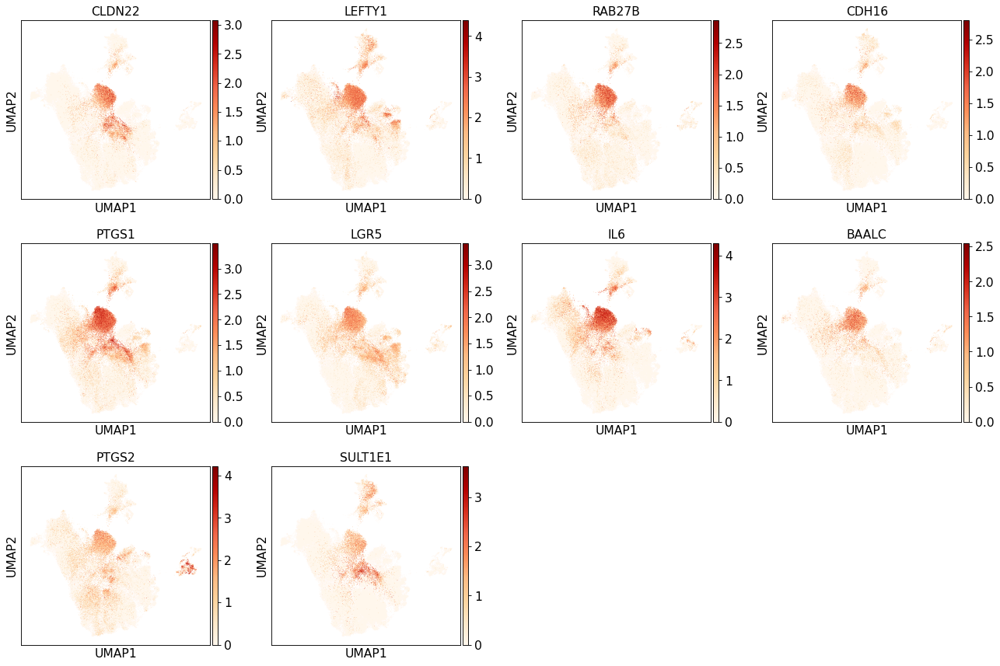

Luminalal late


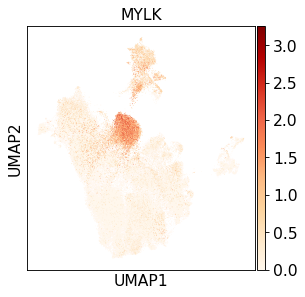

pre-WOI


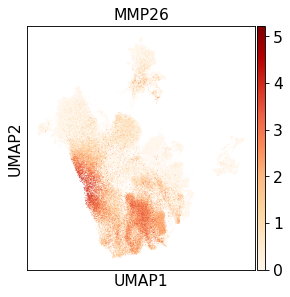

Glandular


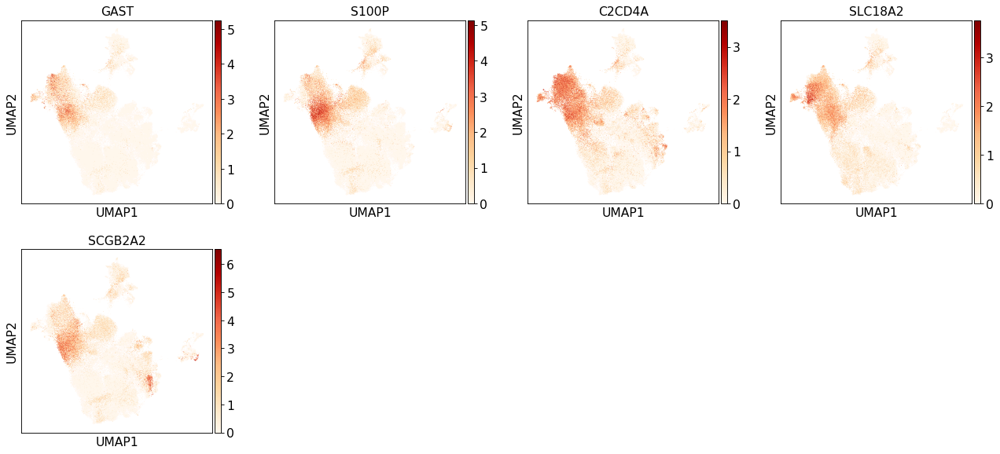

Glandular secretory


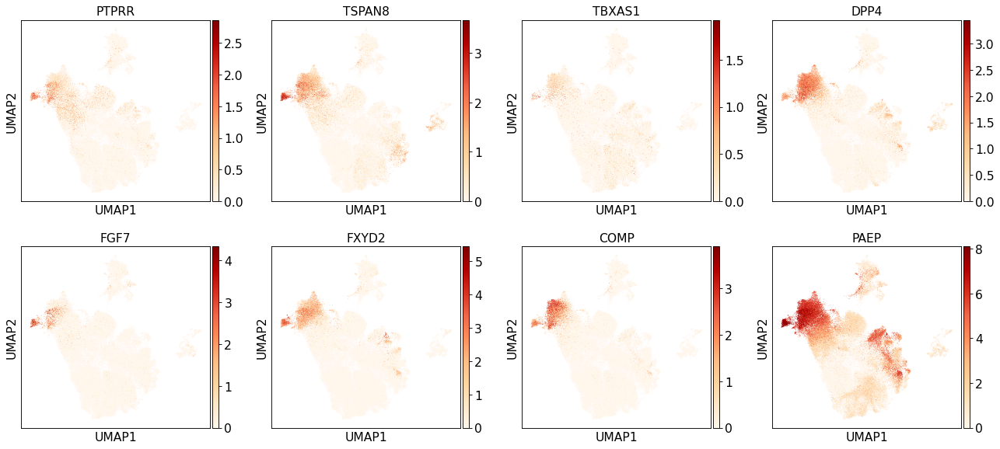

MUC5B+


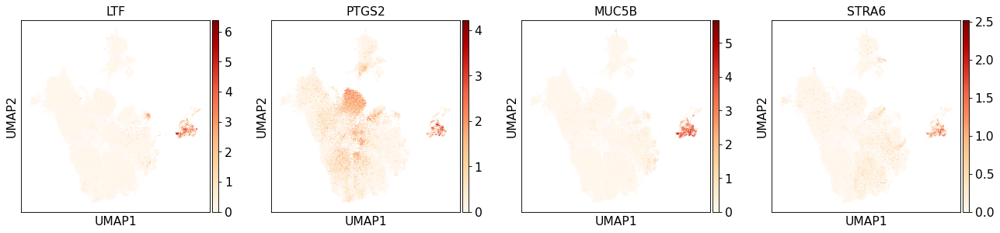

KRT5/TP63


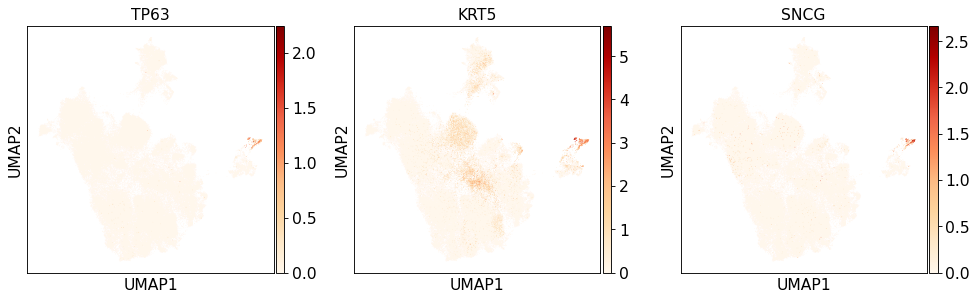

Ciliated Epithelial lineage


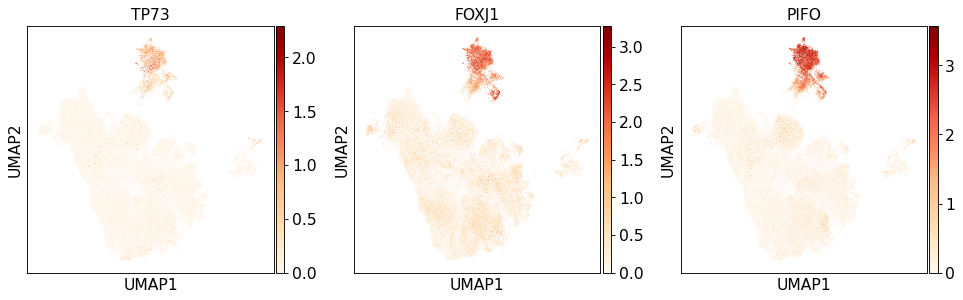

pre-Ciliated


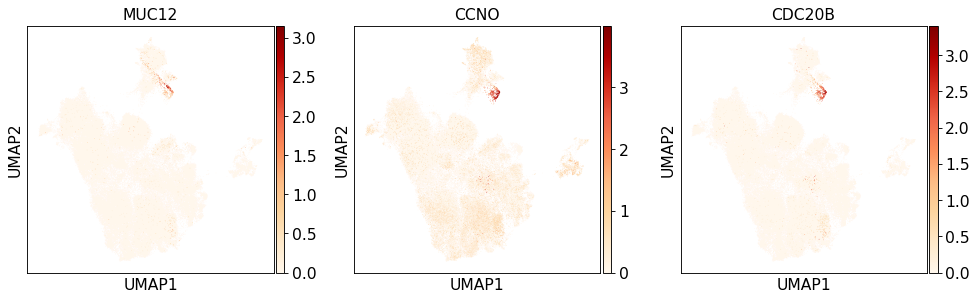

Inflamatory


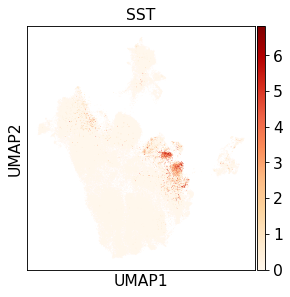

Mesenchymal lineage


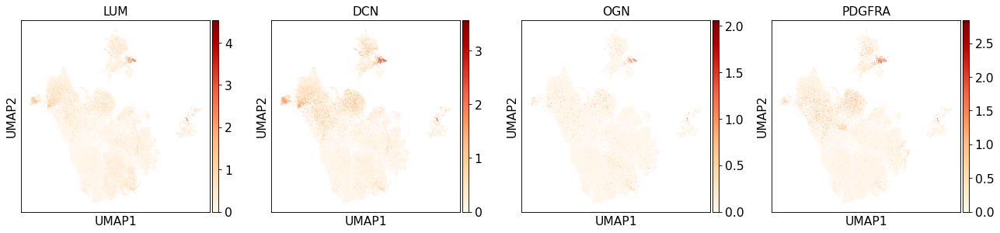

eS


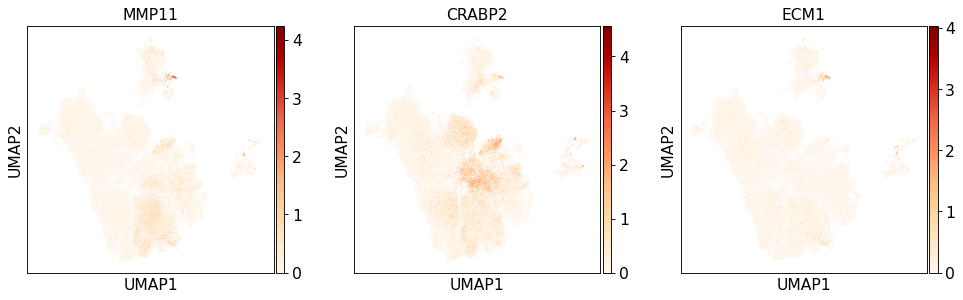

dS


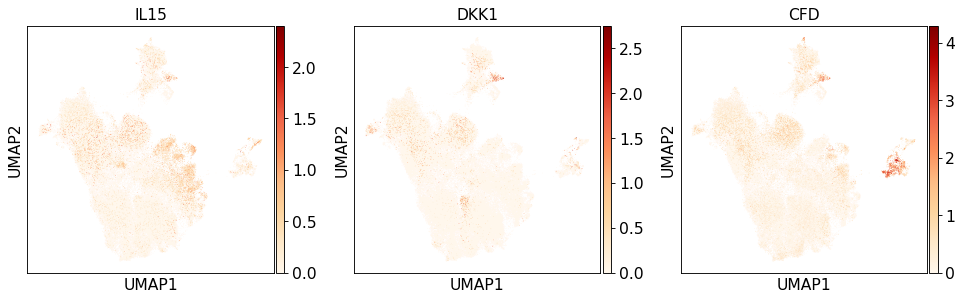

PV lineage


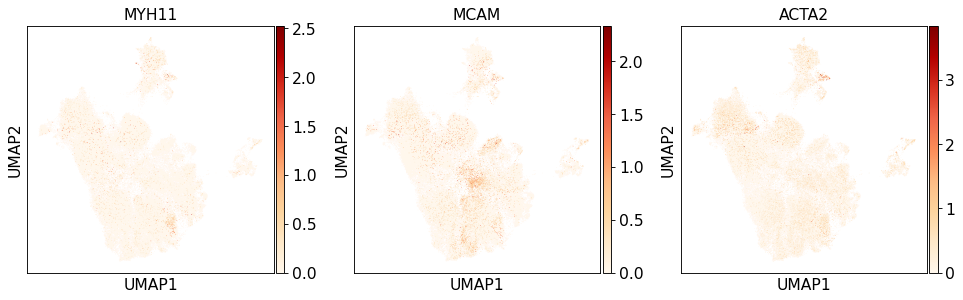

Endothelial


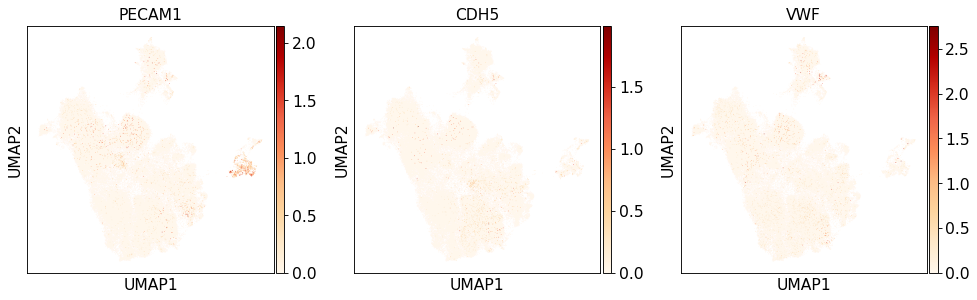

Immune


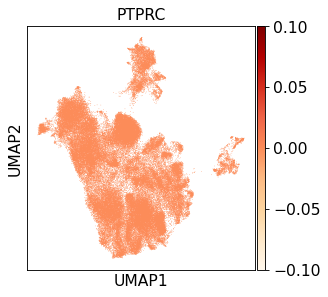

Lymphoid


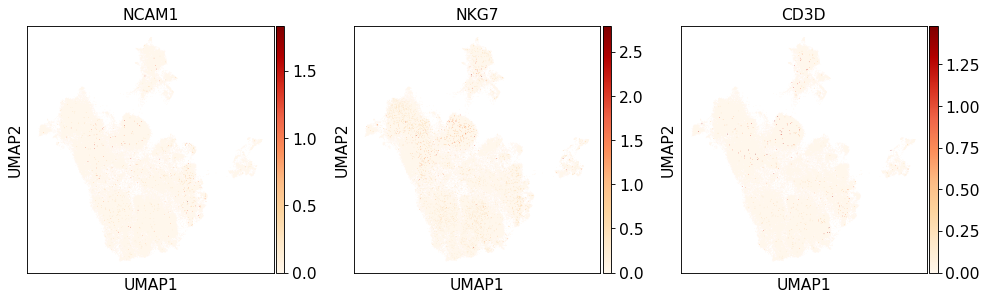

Myeloid


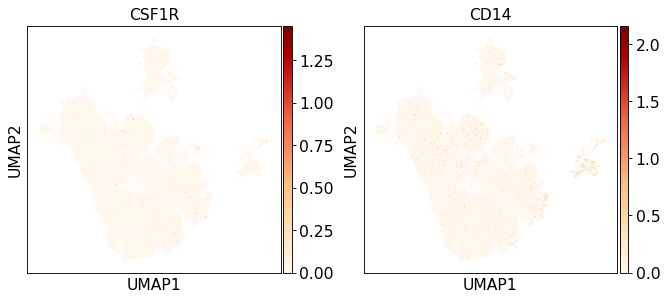

lowQC


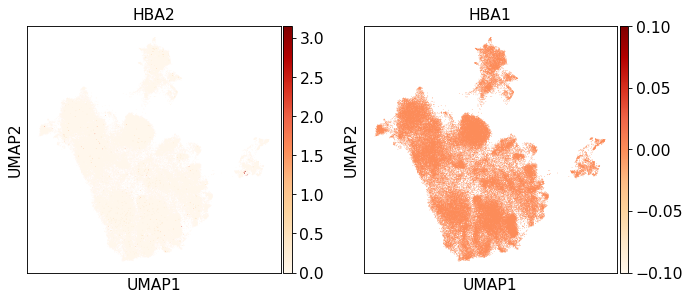

WIF1


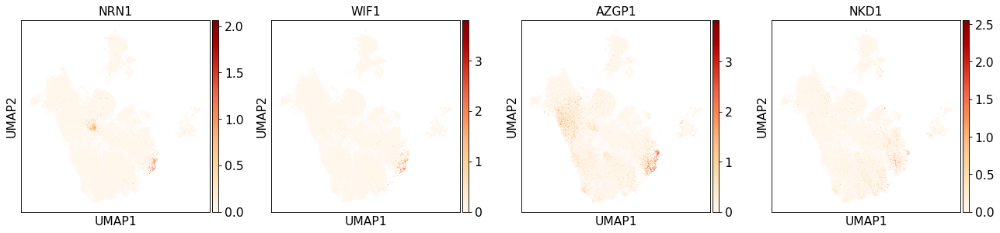

Hormones


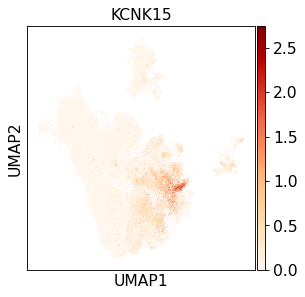

Receptors


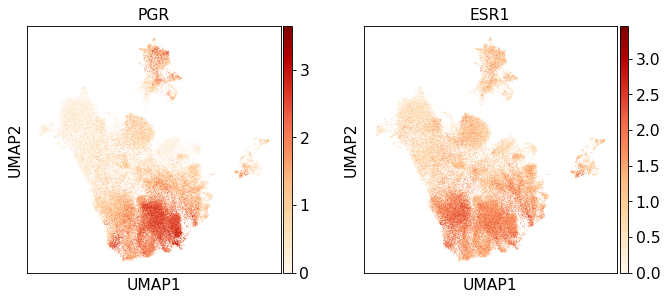

WNT effectors


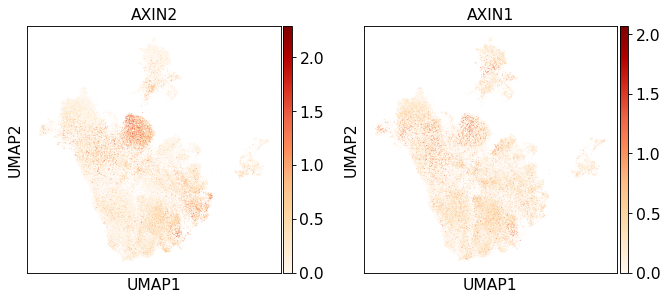

Mesothelial


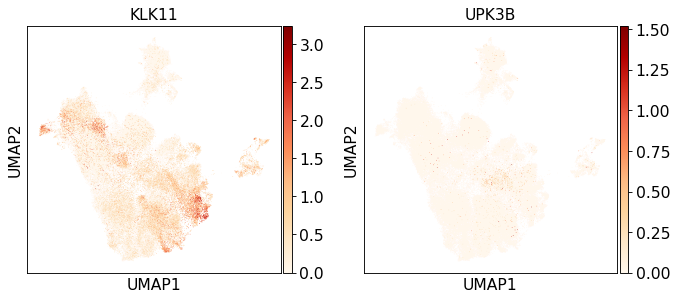

Prostaglandin R


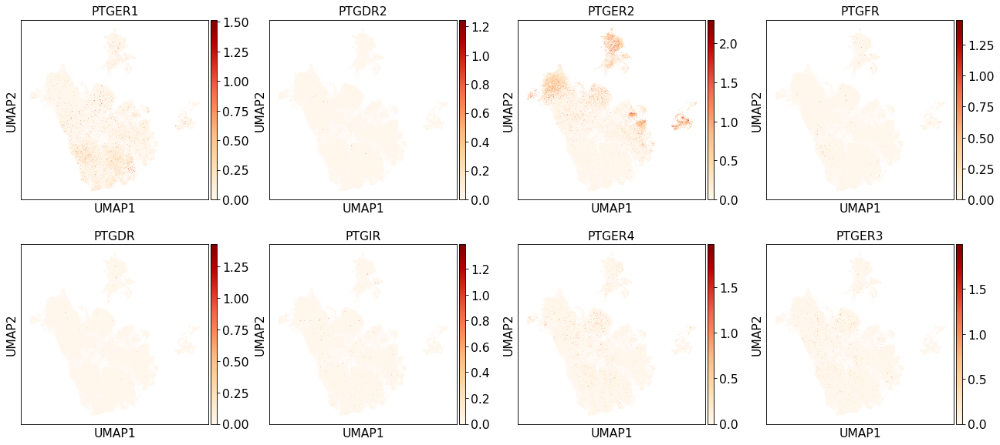

Prostaglandin S


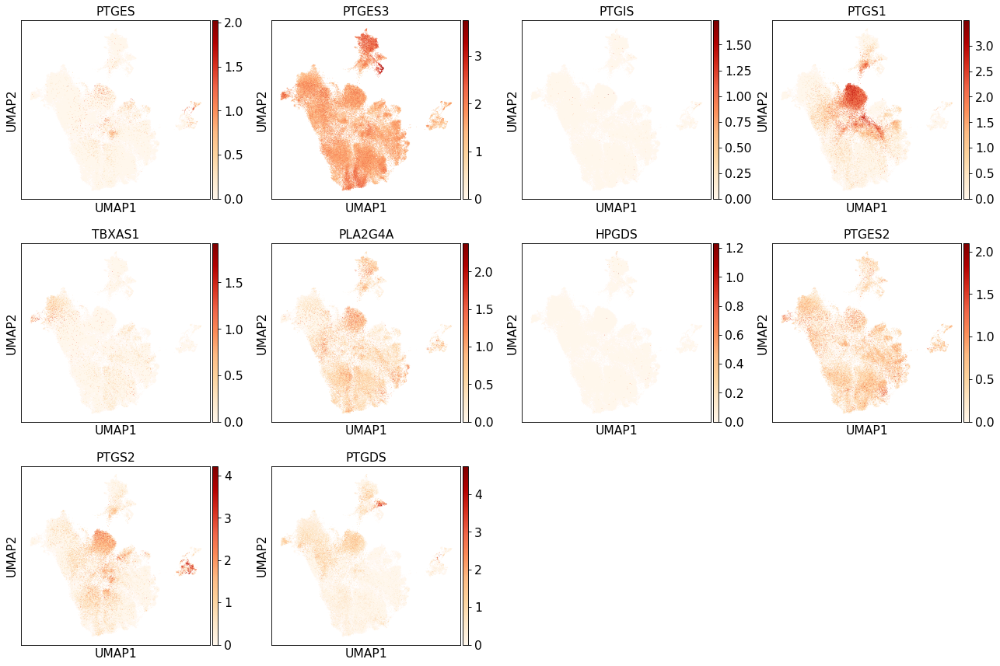

MMPs


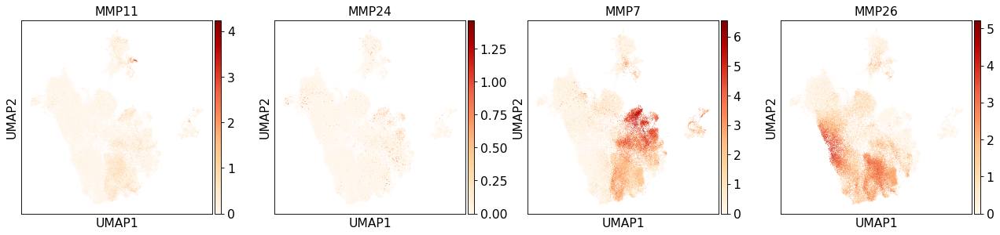

In [27]:
for i in marker_genes.keys():
    print(i)
    sc.pl.umap(adata, color=marker_genes[i], color_map='OrRd', use_raw=False )

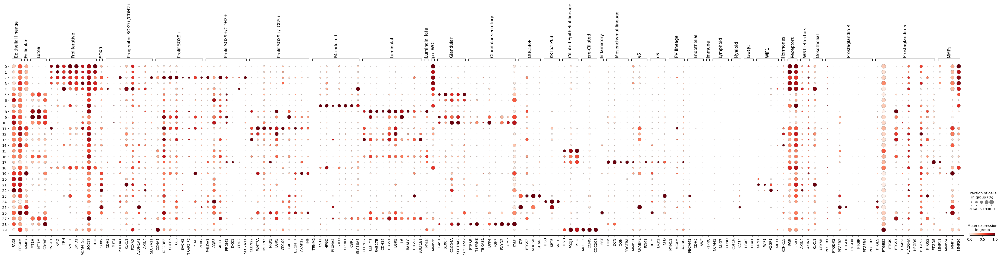

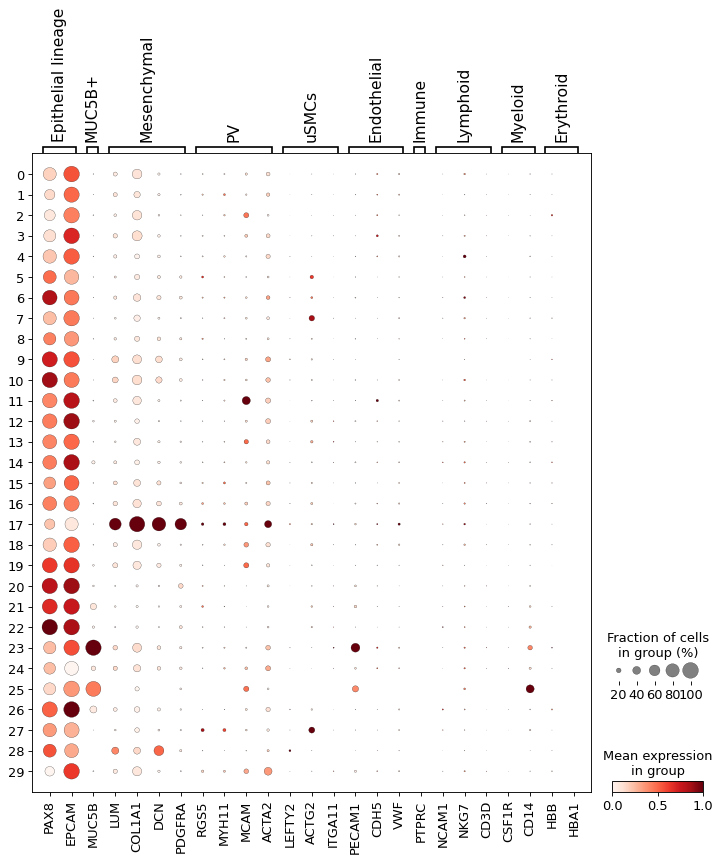

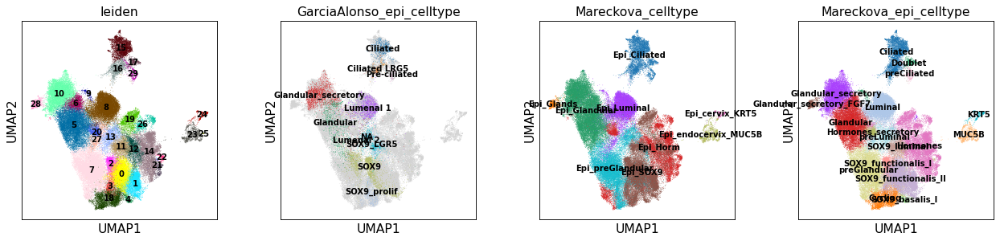

In [28]:
sc.pl.dotplot(adata, marker_genes, groupby='leiden', standard_scale='var', save='MARKERS_leiden.pdf')
sc.pl.dotplot(adata, marker_genes_short, groupby='leiden', standard_scale='var')

sc.pl.umap(adata, color=['leiden', 'GarciaAlonso_epi_celltype', 'Mareckova_celltype', 'Mareckova_epi_celltype'],legend_loc='on data', legend_fontsize=9, save='_leiden.pdf')

... storing 'Mareckova_epi_celltype' as categorical
... storing 'Mareckova_epi_lineage' as categorical


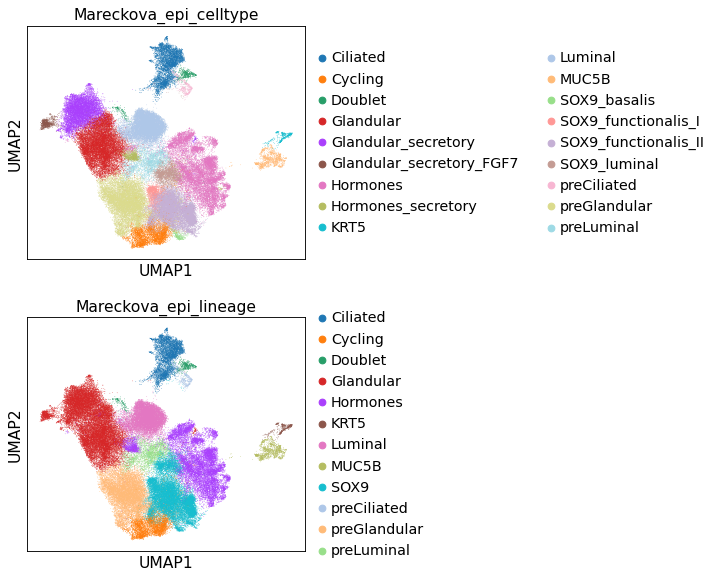

In [52]:
adata.obs['Mareckova_epi_celltype'] = adata.obs['leiden'].tolist()
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '0', 'Mareckova_epi_celltype'] = 'SOX9_functionalis_II'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '1', 'Mareckova_epi_celltype'] = 'SOX9_functionalis_II'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '2', 'Mareckova_epi_celltype'] = 'SOX9_functionalis_I'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '3', 'Mareckova_epi_celltype'] = 'SOX9_functionalis_II'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '4', 'Mareckova_epi_celltype'] = 'SOX9_basalis'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '5', 'Mareckova_epi_celltype'] = 'Glandular'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '6', 'Mareckova_epi_celltype'] = 'Glandular'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '7', 'Mareckova_epi_celltype'] = 'preGlandular'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '8', 'Mareckova_epi_celltype'] = 'Luminal'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '9', 'Mareckova_epi_celltype'] = 'Doublet'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '10', 'Mareckova_epi_celltype'] = 'Glandular_secretory'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '11', 'Mareckova_epi_celltype'] = 'SOX9_luminal'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '12', 'Mareckova_epi_celltype'] = 'Hormones'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '13', 'Mareckova_epi_celltype'] = 'preLuminal'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '14', 'Mareckova_epi_celltype'] = 'Hormones'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '15', 'Mareckova_epi_celltype'] = 'Ciliated'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '16', 'Mareckova_epi_celltype'] = 'Ciliated'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '17', 'Mareckova_epi_celltype'] = 'Doublet'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '18', 'Mareckova_epi_celltype'] = 'Cycling'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '19', 'Mareckova_epi_celltype'] = 'Hormones'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '20', 'Mareckova_epi_celltype'] = 'Hormones_secretory'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '21', 'Mareckova_epi_celltype'] = 'Hormones'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '22', 'Mareckova_epi_celltype'] = 'Hormones'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '23', 'Mareckova_epi_celltype'] = 'MUC5B'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '24', 'Mareckova_epi_celltype'] = 'KRT5'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '25', 'Mareckova_epi_celltype'] = 'MUC5B'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '26', 'Mareckova_epi_celltype'] = 'Hormones'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '27', 'Mareckova_epi_celltype'] = 'preLuminal'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '28', 'Mareckova_epi_celltype'] = 'Glandular_secretory_FGF7'
adata.obs.at[adata.obs['Mareckova_epi_celltype'] == '29', 'Mareckova_epi_celltype'] = 'preCiliated'



set(adata.obs['Mareckova_epi_celltype'])
adata.obs['Mareckova_epi_lineage'] = [str(i).split('_', 1)[0] for i in adata.obs['Mareckova_epi_celltype'] ]

sc.pl.umap(adata, color=['Mareckova_epi_celltype', 'Mareckova_epi_lineage'], ncols=1)
# adata.obs['Mareckova_epi_celltype'].cat.reorder_categories(['Epithelial', 'Epithelial_MUC5B', 'Epithelial_Glandular', 'Epithelial_Ciliated', 'Epithelial_TP63+KRT5+',
#                                                         'Mesothelial', 
#                                                         'Mesenchymal_eS', 'Mesenchymal_dS', 'Mesenchymal_C7', 
#                                                         'PV_STEAP4', 'PV_MYH11', 'uSMCs',
#                                                         'Endothelial', 'Endothelial_LEC', 'Myeloid', 'Lymphoid',
#                                                         'EcO_Mesenchymal',
#                                                         'EcO_Mesenchymal_COL10A1'
#                                                         'EcO_Granulosa', 'EcO_Theca',
#                                                         'LowQC', 'Doublet'], inplace=True)

# sc.pl.umap(adata, color=['Mareckova_epi_celltype'])

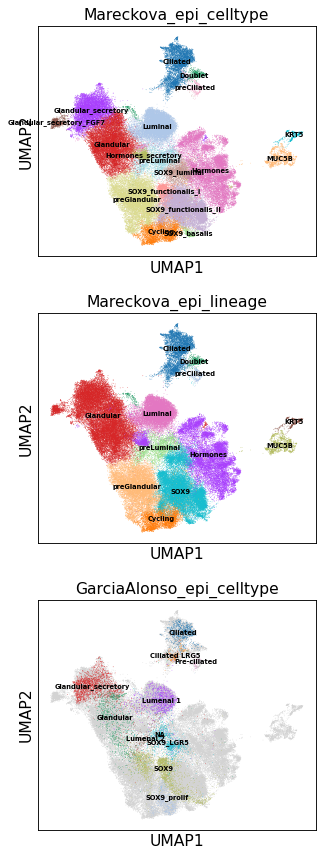

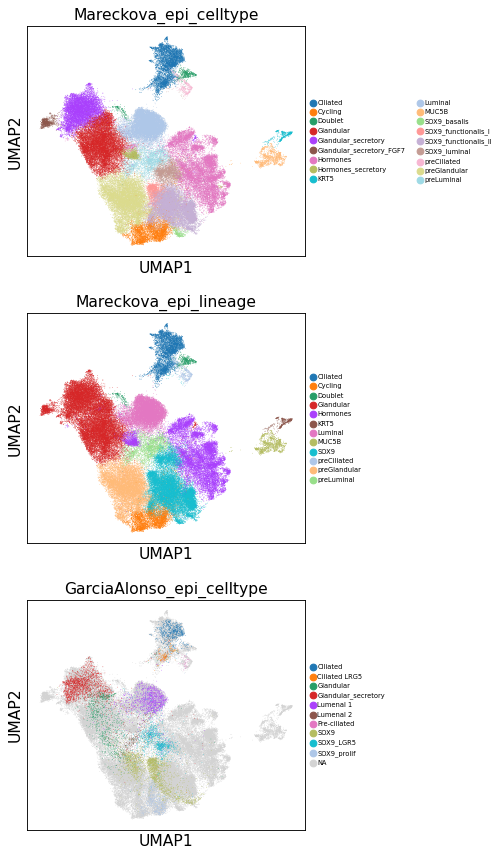

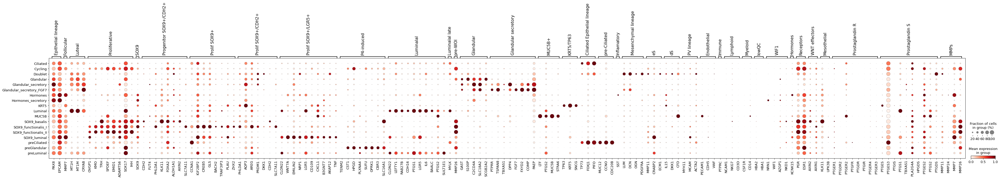

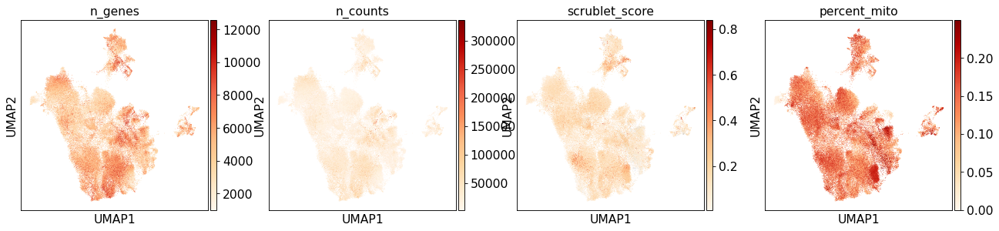

In [53]:
sc.pl.umap(adata, color=['Mareckova_epi_celltype', 'Mareckova_epi_lineage', 'GarciaAlonso_epi_celltype'], legend_loc='on data', legend_fontsize=6, ncols=1, save='_celltype.pdf')
sc.pl.umap(adata, color=['Mareckova_epi_celltype', 'Mareckova_epi_lineage', 'GarciaAlonso_epi_celltype'], legend_fontsize=6, ncols=1, save='_celltype_legend.pdf')

sc.pl.dotplot(adata, marker_genes, groupby='Mareckova_epi_celltype', standard_scale='var', save='MARKERS_celltype.pdf')


sc.pl.umap(adata, color=['n_genes','n_counts','scrublet_score', 'percent_mito'], color_map='OrRd')

... storing 'leiden_celltype' as categorical
... storing 'celltype_leiden' as categorical


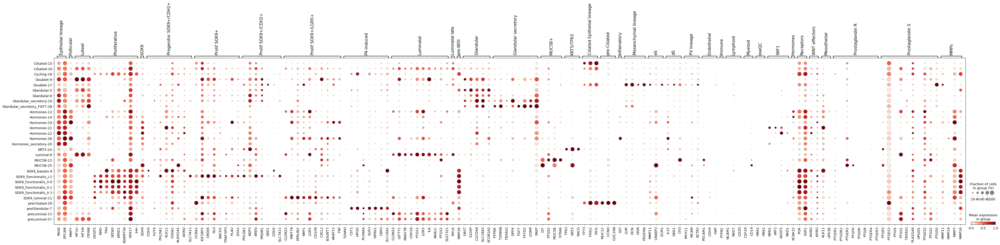

In [54]:
adata.obs['leiden_celltype'] =  [a + '-' + b  for a, b in zip(adata.obs['leiden'], adata.obs['Mareckova_epi_celltype'])]
adata.obs['celltype_leiden'] =  [a + '-' + b  for b, a in zip(adata.obs['leiden'], adata.obs['Mareckova_epi_celltype'])]
sc.pl.dotplot(adata, marker_genes, groupby='celltype_leiden', standard_scale='var')

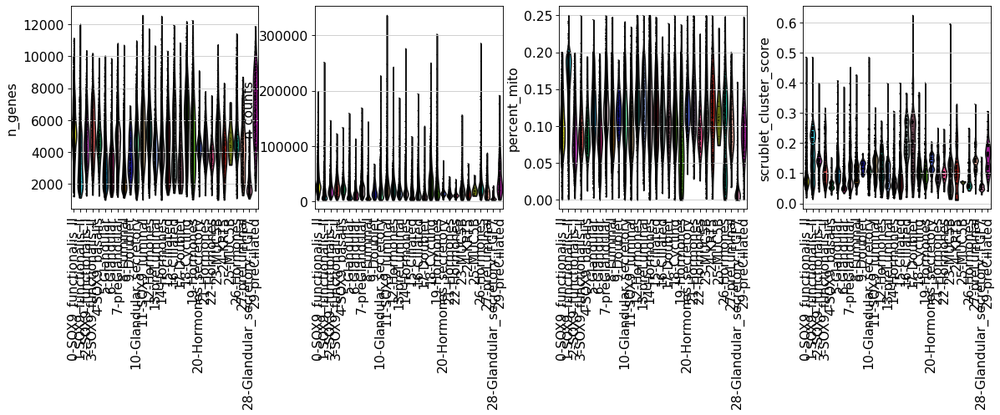

In [55]:
sc.pl.violin(adata, keys= ['n_genes', 'n_counts', 'percent_mito', 'scrublet_cluster_score'], groupby = 'leiden_celltype', rotation = 90)

In [56]:
# adata.write('x.h5ad')
pd.DataFrame(adata.obs).to_csv('/nfs/team292/lg18/endometriosis/annotations/cells_endometrium_epithelial_CLEAN.csv')

In [57]:
sampleID = [a + '-' + b + '-' + c + '-' + d for a, b, c, d in zip(adata.obs['dataset'], 
                                         adata.obs['Stage'], adata.obs['Group'],
                                                     adata.obs['genotype'])]

adata.obs['genotype_dataset'] = sampleID

sampleID = [a + '-' + b + '-' + c + '-' + d for a, b, c, d in zip(adata.obs['Stage'], 
                                                                  adata.obs['genotype'], 
                                                                  adata.obs['Treatment'],
                                                                  adata.obs['library'])]

adata.obs['donor_libary'] = sampleID


sampleID = [a + '-' + b  for a, b in zip(adata.obs['Binary Stage'], 
                                                     adata.obs['Group'])]

adata.obs['Group_stage'] = sampleID

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() g

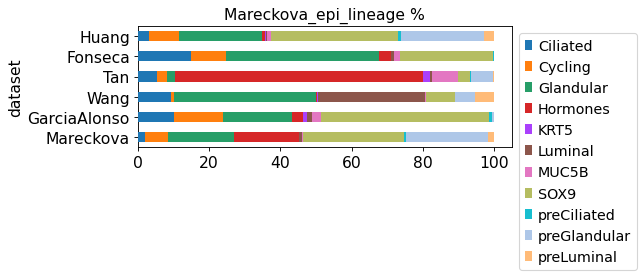

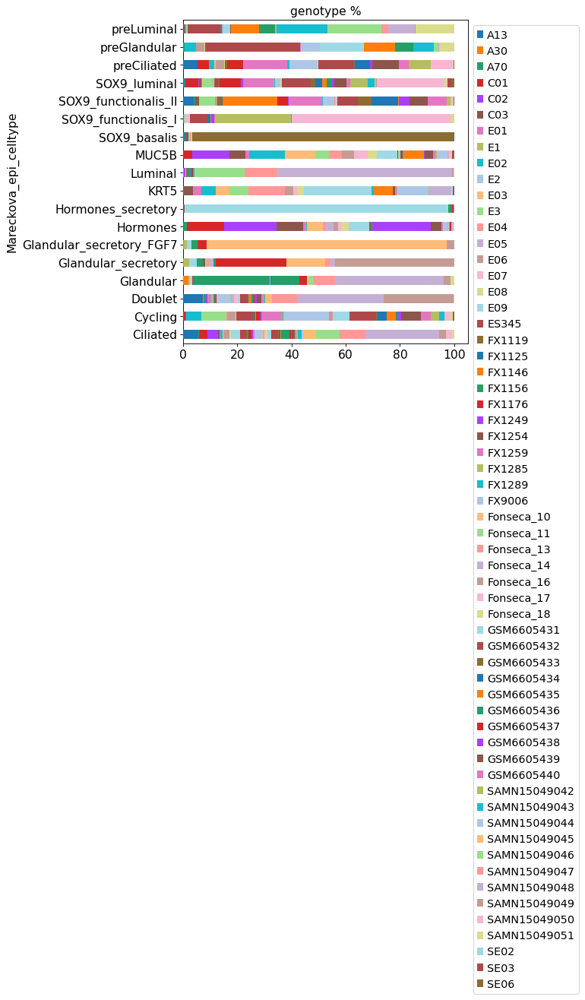

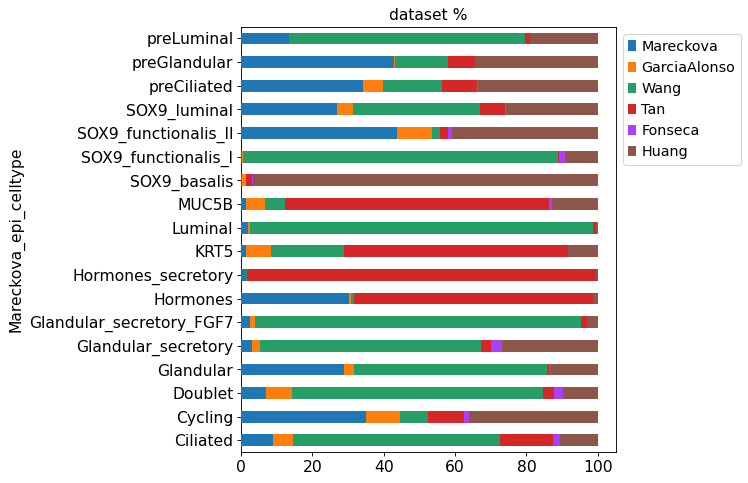

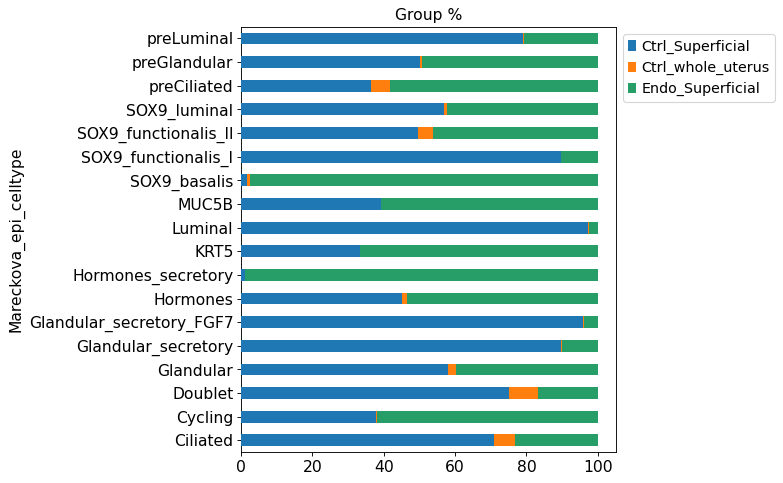

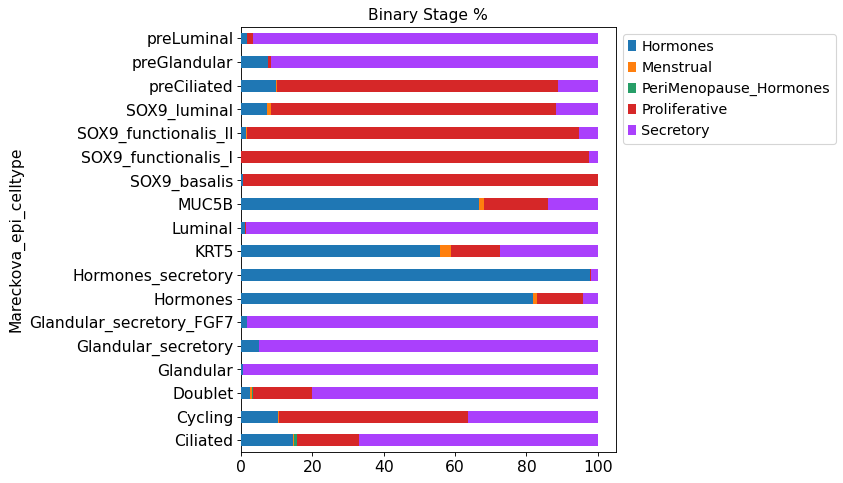

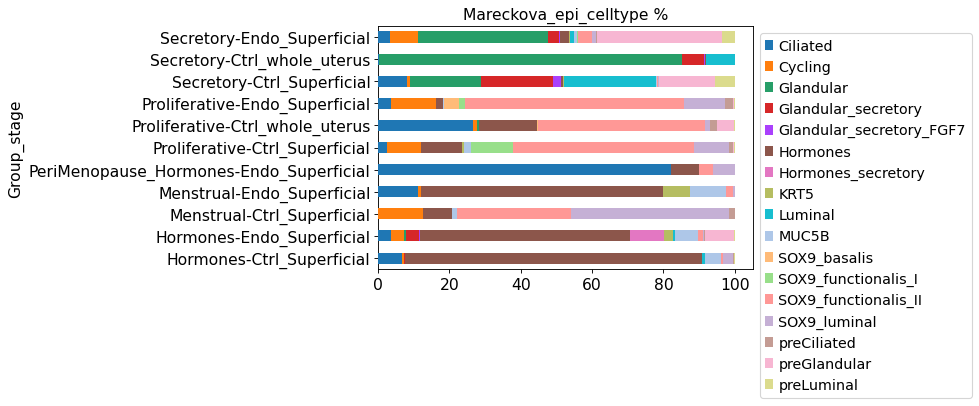

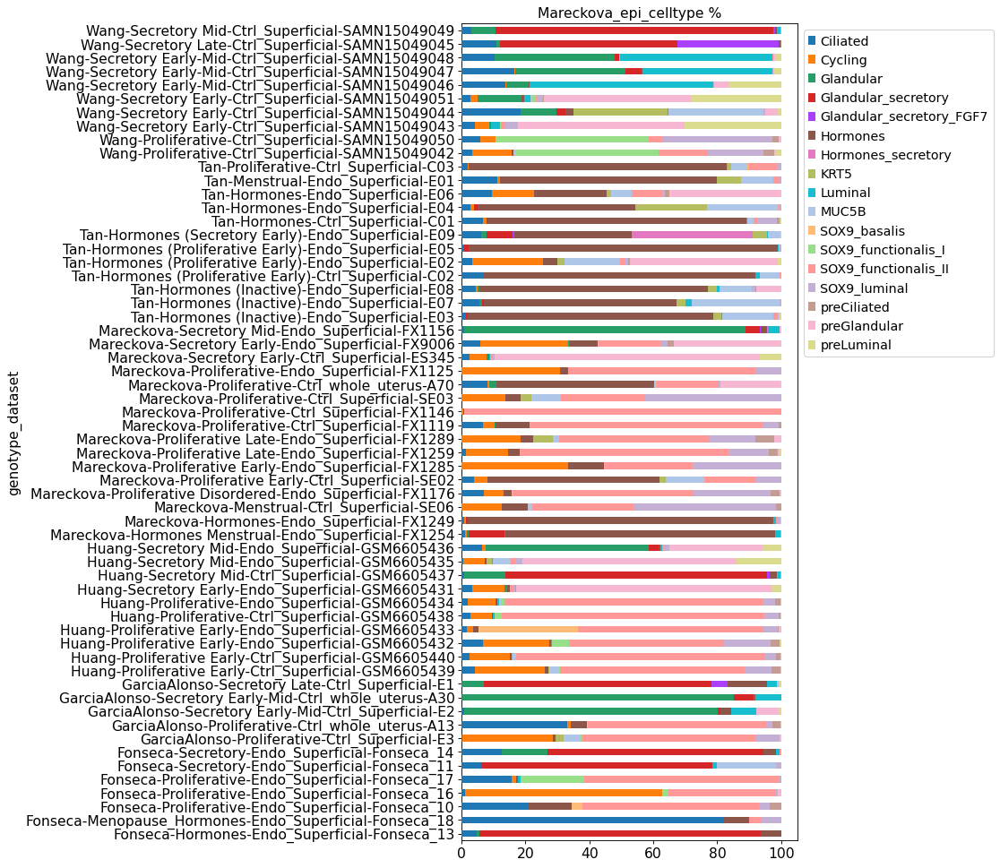

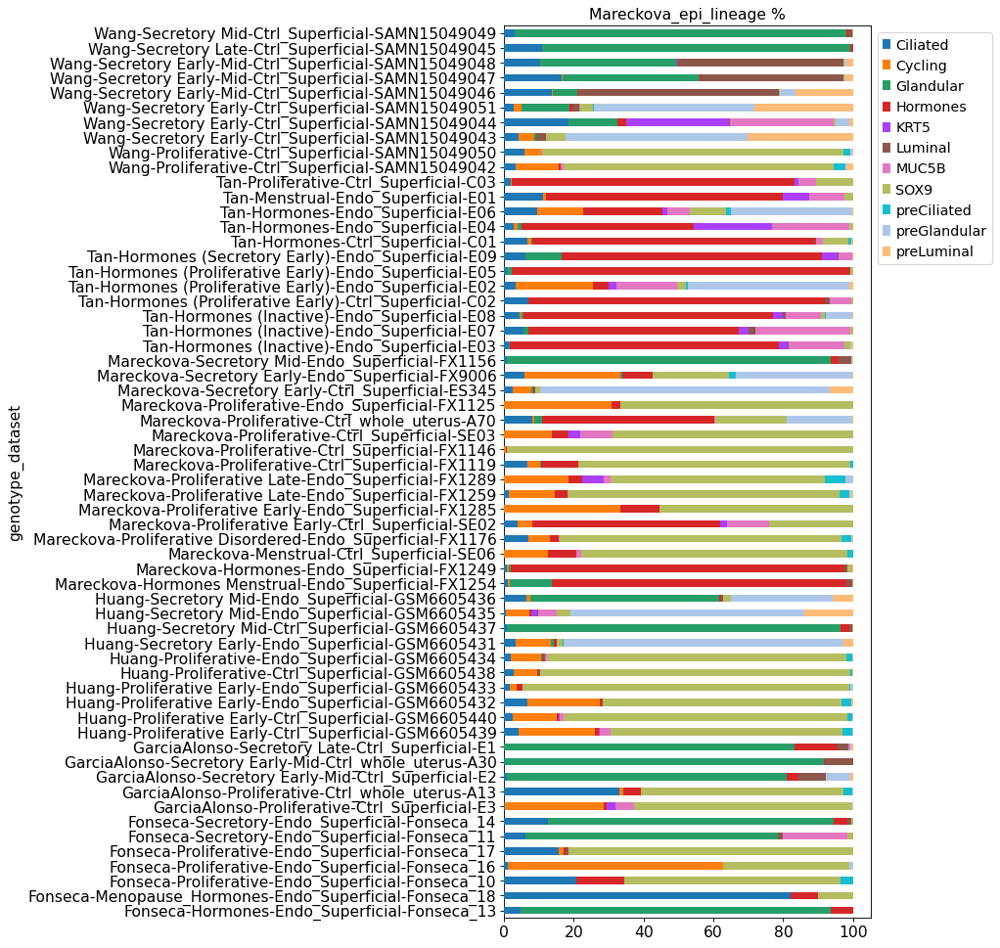

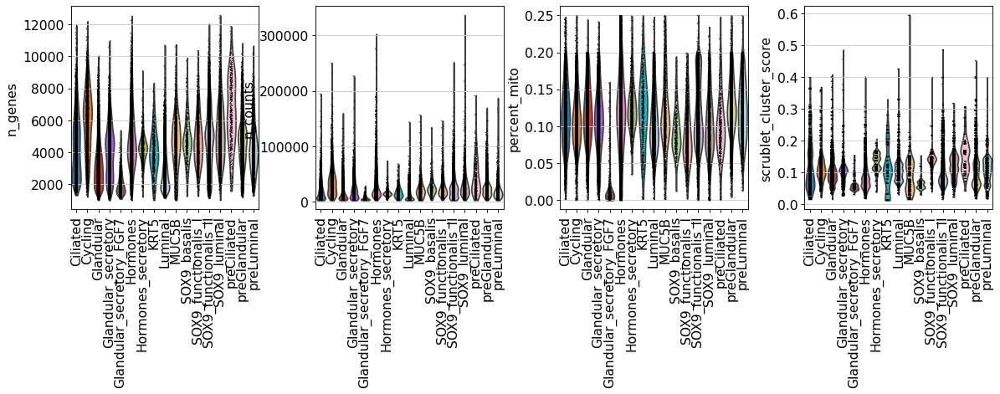

In [58]:
X = adata[[i not in ['Doublet', 'LowQC', 'Other'] for i in adata.obs.Mareckova_epi_celltype ]]
Barplot('Mareckova_epi_lineage', X, var='dataset', height=2)
Barplot('genotype', adata, var='Mareckova_epi_celltype', height=7)
Barplot('dataset', adata, var='Mareckova_epi_celltype', height=7)
Barplot('Group', adata, var='Mareckova_epi_celltype', height=7)
Barplot('Binary Stage', adata, var='Mareckova_epi_celltype', height=7)

Barplot('Mareckova_epi_celltype', X, var='Group_stage', height=4)
Barplot('Mareckova_epi_celltype', X, var='genotype_dataset', height=15)
Barplot('Mareckova_epi_lineage', X, var='genotype_dataset', height=15)
sc.pl.violin(X, keys= ['n_genes', 'n_counts', 'percent_mito', 'scrublet_cluster_score'], groupby = 'Mareckova_epi_celltype', rotation = 90)

In [59]:
adata.obs['Mareckova_epi_celltype'].values.describe()

,counts,freqs
categories,,
Ciliated,5236,0.057392
Cycling,4129,0.045258
Doublet,669,0.007333
Glandular,13050,0.143042
Glandular_secretory,8610,0.094375
Glandular_secretory_FGF7,804,0.008813
Hormones,13287,0.145640
Hormones_secretory,1094,0.011991
KRT5,484,0.005305


# TF-IDF

In [60]:
import anndata
adataDown = adata[[ i in ["G1"] for i in adata.obs.phase ]]
sc.pp.filter_cells(adataDown, min_genes=2000)
sc.pp.filter_genes(adataDown, min_cells=5)
# print(adataDown.obs['leiden'].value_counts())

### Dowsample the whole dataset UN-EVEN
# adataDown = sc.pp.subsample(XX, fraction=0.25, random_state=0, copy=True) 


### Downsample to the smallest pop size
target_cells = 50

adataDown.obs['cell'] = adataDown.obs.index
adatas = [adataDown[adataDown.obs['leiden'].isin([cl])] for cl in adataDown.obs['leiden'].cat.categories]
# adatas = [adataDown[ adataDown.obs['leiden']==cl ] for cl in adataDown.obs['leiden'].cat.categories]

for dat in adatas:
    if dat.n_obs > target_cells:
        sc.pp.subsample(dat, n_obs=target_cells, random_state=0)
adata_downsampled = adatas[0].concatenate(*adatas[1:])
adataDown = adataDown[[ i in adata_downsampled.obs.cell.tolist() for i in adataDown.obs['cell'] ]]

sc.pp.filter_genes(adataDown, min_cells=10)
print(adataDown.obs['leiden'].value_counts())

del adata_downsampled
del adatas

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
filtered out 11335 cells that have less than 2000 genes expressed
Trying to set attribute `.obs` of view, copying.
filtered out 98 genes that are detected in less than 5 cells
filtered out 2602 genes that are detected in less than 10 cells
Trying to set attribute `.var` of view, copying.


0     50
1     50
28    50
27    50
26    50
24    50
23    50
22    50
21    50
20    50
19    50
18    50
17    50
16    50
15    50
14    50
13    50
12    50
11    50
10    50
9     50
8     50
7     50
6     50
5     50
4     50
3     50
2     50
29    50
25    17
Name: leiden, dtype: int64


In [61]:
import rpy2.rinterface_lib.callbacks
import logging
# Itoliste R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)
import anndata2ri
anndata2ri.activate()
%load_ext rpy2.ipython


The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


In [62]:
# This is just to allow moving adata to R without errors
adataDown.X = adataDown.X.toarray()

idx = ['n_genes', 'sample',  'percent_mito', 'n_counts', 'batch', 'S_score', 'G2M_score', 'phase', 
       'scrublet_score', 'scrublet_cluster_score', 'zscore', 'bh_pval', 'bonf_pval', 'is_doublet']
for i in idx:
    del adataDown.obs[i]
    
adataDown.obs['leiden'] = adataDown.obs['leiden'].astype(str)

del adataDown.obsm['X_scVI']
del adataDown.obsm['X_umap']
del adataDown.obsp['connectivities']
del adataDown.obsp['distances']
del adataDown.uns

In [63]:
%%R -i adataDown
adataDown

class: SingleCellExperiment 
dim: 15036 1467 
metadata(0):
assays(1): X
rownames(15036): A1BG A2M ... ZYX ZZEF1
rowData names(220): gene_ids.0.Fonseca feature_types.0.Fonseca ...
  highly_variable_nbatches n_cells
colnames(1467): GSM6605432_TCTGCCACAGCACAGA-Huang
  UA_Endo12680032_CACCGTTTCAGCTAGT-Mareckova ...
  E03_EuE_CTATAGGGTGTACAGG-Tan GSM6605432_GGGAGTAGTAGTATAG-Huang
colData names(66): library StudyName ... Group_stage cell
reducedDimNames(0):
altExpNames(0):


### By Leiden

In [64]:
%%R -o df_tfIDF -o topgenes_tfIDF

library(Seurat)
library(SoupX)
library(dplyr)
seurat_andata = as.Seurat(adataDown, counts = "X", data = "X")
Idents(seurat_andata) = seurat_andata$celltype_leiden


df_tfIDF = quickMarkers(toc = seurat_andata@assays$RNA@counts, clusters = Idents(seurat_andata), N = 500)

df_tfIDF$cluster = factor(df_tfIDF$cluster, levels = unique(sort(df_tfIDF$cluster))  )
topgenes_tfIDF = subset(df_tfIDF, qval <= 0.05) %>%
  group_by(cluster) %>%
  group_map(~ head(.x, 20L)$gene)
names(topgenes_tfIDF) = paste('cl', levels(df_tfIDF$cluster) )

In [65]:
df_tfIDF.to_csv('TFIDF_leiden.tsv', index=False, sep='\t')

... storing 'genotype_dataset' as categorical
... storing 'donor_libary' as categorical
... storing 'Group_stage' as categorical


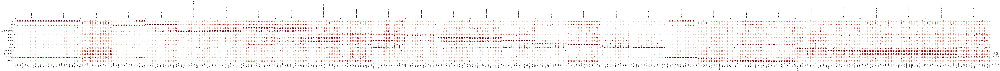

In [66]:
topgenes_tfIDF = dict(zip(topgenes_tfIDF.names, map(list,list(topgenes_tfIDF)))) # this is to convert into a dictionary for plotting
for i in topgenes_tfIDF.keys():
    topgenes_tfIDF[i] = [value for value in topgenes_tfIDF[i] if value in adata.var_names] 
    

    
sc.pl.dotplot(adata, topgenes_tfIDF, groupby='celltype_leiden', standard_scale = 'var', save='TFIDF_leiden.pdf')#topgenes_tfIDF

## By celltype

In [67]:
import anndata
adataDown = adata[[ i not in ['Doublet', 'LowQC', 'Cycling', 'Donor-specific', 'Hormones'] for i in adata.obs.Mareckova_epi_celltype ]]
sc.pp.filter_cells(adataDown, min_genes=1000)
sc.pp.filter_genes(adataDown, min_cells=5)
# print(adataDown.obs['leiden'].value_counts())

### Dowsample the whole dataset UN-EVEN
# adataDown = sc.pp.subsample(XX, fraction=0.25, random_state=0, copy=True) 


### Downsample to the smallest pop size
target_cells = 100

adataDown.obs['cell'] = adataDown.obs.index
adatas = [adataDown[adataDown.obs['Mareckova_epi_celltype'].isin([cl])] for cl in adataDown.obs['Mareckova_epi_celltype'].cat.categories]
# adatas = [adataDown[ adataDown.obs['leiden']==cl ] for cl in adataDown.obs['leiden'].cat.categories]

for dat in adatas:
    if dat.n_obs > target_cells:
        sc.pp.subsample(dat, n_obs=target_cells, random_state=0)
adata_downsampled = adatas[0].concatenate(*adatas[1:])
adataDown = adataDown[[ i in adata_downsampled.obs.cell.tolist() for i in adataDown.obs['cell'] ]]

sc.pp.filter_genes(adataDown, min_cells=10)
print(adataDown.obs['Mareckova_epi_celltype'].value_counts())

del adata_downsampled
del adatas

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
filtered out 14 cells that have less than 1000 genes expressed
Trying to set attribute `.obs` of view, copying.
filtered out 116 genes that are detected in less than 5 cells
filtered out 2576 genes that are detected in less than 10 cells
Trying to set attribute `.var` of view, copying.


Ciliated                    100
Glandular                   100
Glandular_secretory         100
Glandular_secretory_FGF7    100
Hormones_secretory          100
KRT5                        100
Luminal                     100
MUC5B                       100
SOX9_basalis                100
SOX9_functionalis_I         100
SOX9_functionalis_II        100
SOX9_luminal                100
preCiliated                 100
preGlandular                100
preLuminal                  100
Name: Mareckova_epi_celltype, dtype: int64


In [68]:
# This is just to allow moving adata to R without errors
adataDown.X = adataDown.X.toarray()

idx = ['n_genes', 'sample',  'percent_mito', 'n_counts', 'batch', 'S_score', 'G2M_score', 'phase', 
       'scrublet_score', 'scrublet_cluster_score', 'zscore', 'bh_pval', 'bonf_pval', 'is_doublet']
for i in idx:
    del adataDown.obs[i]
    
adataDown.obs['leiden'] = adataDown.obs['leiden'].astype(str)

del adataDown.obsm['X_scVI']
del adataDown.obsm['X_umap']
del adataDown.obsp['connectivities']
del adataDown.obsp['distances']
del adataDown.uns

In [69]:
%%R -i adataDown
adataDown

class: SingleCellExperiment 
dim: 15044 1500 
metadata(0):
assays(1): X
rownames(15044): A1BG A2M ... ZYX ZZEF1
rowData names(220): gene_ids.0.Fonseca feature_types.0.Fonseca ...
  highly_variable_nbatches n_cells
colnames(1500): GSM4577309_CACGTGGAGTACTGTC-Wang
  UA_Endo12680032_CTGGCAGGTCACCACG-Mareckova ...
  GSM6605434_AGATCCACATCAGTCA-Huang GSM4577309_GTCCTCACAAGAGCTG-Wang
colData names(66): library StudyName ... Group_stage cell
reducedDimNames(0):
altExpNames(0):


In [70]:
%%R -o df_tfIDF -o topgenes_tfIDF

library(Seurat)
library(SoupX)
library(dplyr)
seurat_andata = as.Seurat(adataDown, counts = "X", data = "X")
Idents(seurat_andata) = seurat_andata$Mareckova_epi_celltype


df_tfIDF = quickMarkers(toc = seurat_andata@assays$RNA@counts, clusters = Idents(seurat_andata), N = 500)

df_tfIDF$cluster = factor(df_tfIDF$cluster, levels = unique(df_tfIDF$cluster)  )
topgenes_tfIDF = subset(df_tfIDF, qval <= 1) %>%
  group_by(cluster) %>%
  group_map(~ head(.x, 30L)$gene)
names(topgenes_tfIDF) = unique(df_tfIDF$cluster)

In [71]:
df_tfIDF.to_csv('TFIDF_allcells_Mareckova_epi_celltype.tsv', index=False, sep='\t')

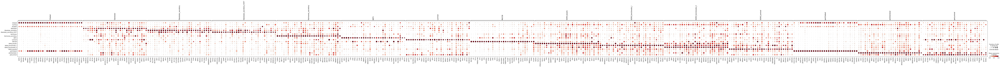

In [72]:
topgenes_tfIDF = dict(zip(topgenes_tfIDF.names, map(list,list(topgenes_tfIDF)))) # this is to convert into a dictionary for plotting
for i in topgenes_tfIDF.keys():
    topgenes_tfIDF[i] = [value for value in topgenes_tfIDF[i] if value in adata.var_names] 
    

    
sc.pl.dotplot(adata, topgenes_tfIDF, groupby='Mareckova_epi_celltype', standard_scale = 'var', save='TFIDF_epithelial_Mareckova_epi_celltype.pdf')#topgenes_tfIDF

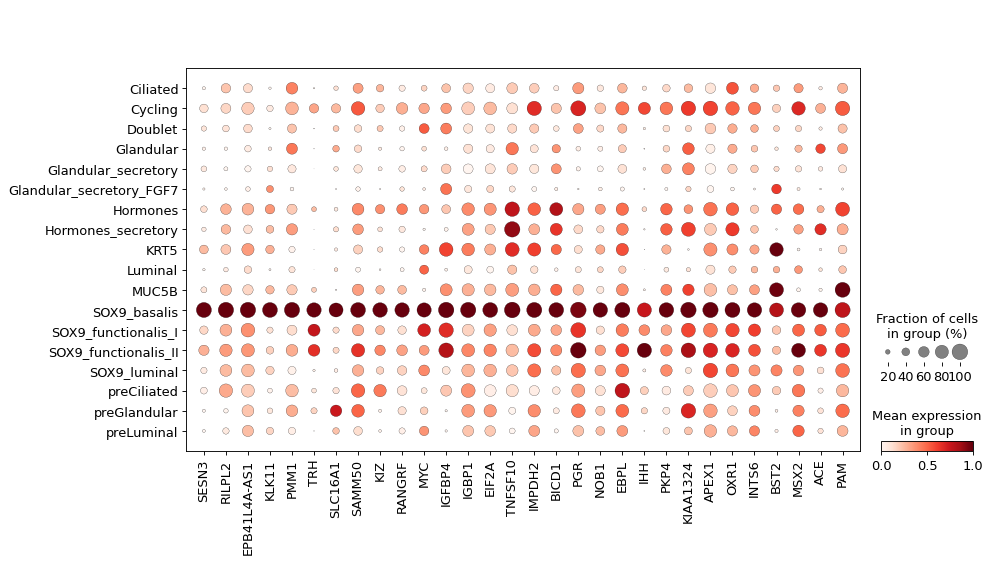

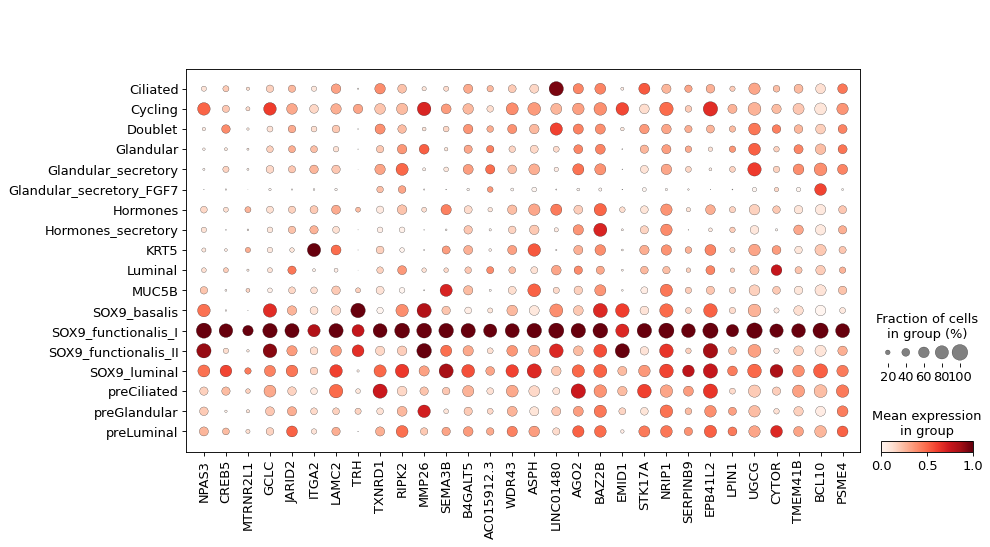

In [73]:
sc.pl.dotplot(adata, topgenes_tfIDF['SOX9_basalis'], groupby='Mareckova_epi_celltype', standard_scale = 'var')#topgenes_tfID
sc.pl.dotplot(adata, topgenes_tfIDF['SOX9_functionalis_I'], groupby='Mareckova_epi_celltype', standard_scale = 'var')#topgenes_tfID

### Compare WOI Glandular - ctrl vs endo
#### all datasets

In [74]:
import anndata
adataDown = adata[adata[: , 'HBB'].X < 0.1, :] 
adataDown = adataDown[[ not i in ['Huang'] for i in adataDown.obs.dataset ]]
adataDown = adataDown[[ i in ['Glandular'] for i in adataDown.obs.Mareckova_epi_celltype ]]
adataDown = adataDown[[ 'G1' in i for i in adataDown.obs.phase ]]
adataDown = adataDown[[ 'Ctrl_whole_uterus' not in i for i in adataDown.obs.Group ]]
adataDown = adataDown[[ i in ['Secretory'] for i in adataDown.obs['Binary Stage'] ]]

sc.pp.filter_cells(adataDown, min_genes=1000)
sc.pp.filter_genes(adataDown, min_cells=5)
# print(adataDown.obs['leiden'].value_counts())

### Dowsample the whole dataset UN-EVEN
# adataDown = sc.pp.subsample(XX, fraction=0.25, random_state=0, copy=True) 


### Downsample to the smallest pop size
target_cells = 1000

adataDown.obs['cell'] = adataDown.obs.index
adatas = [adataDown[adataDown.obs['Group'].isin([cl])] for cl in adataDown.obs['Group'].cat.categories]
# adatas = [adataDown[ adataDown.obs['leiden']==cl ] for cl in adataDown.obs['leiden'].cat.categories]

for dat in adatas:
    if dat.n_obs > target_cells:
        sc.pp.subsample(dat, n_obs=target_cells, random_state=0)
adata_downsampled = adatas[0].concatenate(*adatas[1:])
adataDown = adataDown[[ i in adata_downsampled.obs.cell.tolist() for i in adataDown.obs['cell'] ]]

sc.pp.filter_genes(adataDown, min_cells=10)
print(adataDown.obs['Group'].value_counts())

del adata_downsampled
del adatas

set(adataDown.obs.Mareckova_epi_celltype)

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/scipy/sparse/compressed.py:290: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  warn(bad_scalar_msg, SparseEfficiencyWarning)
filtered out 7 cells that have less than 1000 genes expressed
Trying to set attribute `.obs` of view, copying.
filtered out 1314 genes that are detected in less than 5 cells
filtered out 2814 genes that are detected in less than 10 cells
Trying to set attribute `.var` of view, copying.


Ctrl_Superficial    1000
Endo_Superficial    1000
Name: Group, dtype: int64


{'Glandular'}

In [75]:
# This is just to allow moving adata to R without errors
adataDown.X = adataDown.X.toarray()

idx = ['n_genes', 'sample',  'percent_mito', 'n_counts', 'batch', 'S_score', 'G2M_score', 'phase', 
       'scrublet_score', 'scrublet_cluster_score', 'zscore', 'bh_pval', 'bonf_pval', 'is_doublet']
for i in idx:
    del adataDown.obs[i]
    
adataDown.obs['leiden'] = adataDown.obs['leiden'].astype(str)

del adataDown.obsm['X_scVI']
del adataDown.obsm['X_umap']
del adataDown.obsp['connectivities']
del adataDown.obsp['distances']
del adataDown.uns

In [76]:
%%R -i adataDown
adataDown

class: SingleCellExperiment 
dim: 13608 2000 
metadata(0):
assays(1): X
rownames(13608): A1BG A2M ... ZYX ZZEF1
rowData names(220): gene_ids.0.Fonseca feature_types.0.Fonseca ...
  highly_variable_nbatches n_cells
colnames(2000): UA_Endo10298213_TTCCAATAGACTGTTC-Mareckova
  UA_Endo10298213_TGCCGAGGTAGATCGG-Mareckova ...
  GSM4577309_CAGCAGCGTTTGTGGT-Wang
  UA_Endo10298213_GATCACATCTGTGCGG-Mareckova
colData names(66): library StudyName ... Group_stage cell
reducedDimNames(0):
altExpNames(0):


In [77]:
%%R -o df_tfIDF -o topgenes_tfIDF

library(Seurat)
library(SoupX)
library(dplyr)
seurat_andata = as.Seurat(adataDown, counts = "X", data = "X")
Idents(seurat_andata) = seurat_andata$Group


df_tfIDF = quickMarkers(toc = seurat_andata@assays$RNA@counts, clusters = Idents(seurat_andata), N = 500)

df_tfIDF$cluster = factor(df_tfIDF$cluster, levels = unique(df_tfIDF$cluster)  )
topgenes_tfIDF = subset(df_tfIDF, qval <= 1) %>%
  group_by(cluster) %>%
  group_map(~ head(.x, 200L)$gene)
names(topgenes_tfIDF) = unique(df_tfIDF$cluster)

In [78]:
df_tfIDF.to_csv('TFIDF_cells_WOIepi_endo_vs_ctrl.tsv', index=False, sep='\t')

... storing 'leiden' as categorical


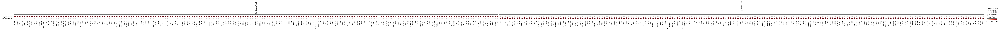

In [79]:
topgenes_tfIDF = dict(zip(topgenes_tfIDF.names, map(list,list(topgenes_tfIDF)))) # this is to convert into a dictionary for plotting
for i in topgenes_tfIDF.keys():
    topgenes_tfIDF[i] = [value for value in topgenes_tfIDF[i] if value in adata.var_names] 
    

    
sc.pl.dotplot(adataDown, topgenes_tfIDF, groupby='Group', standard_scale = 'var', save='TFIDF_WOIepithelial_Mareckova_epi_celltype.pdf')#topgenes_tfIDF

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


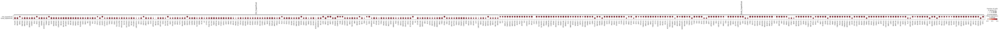

In [80]:
X = adata[[ i in ['Glandular'] for i in adata.obs.Mareckova_epi_celltype ]]
X = X[[ 'G1' in i for i in X.obs.phase ]]
X = X[[ 'Ctrl_whole_uterus' not in i for i in X.obs.Group ]]
X = X[[ i in ['Secretory'] for i in X.obs['Binary Stage'] ]]
X = X[[ i in ['Huang'] for i in X.obs.dataset ]]


sc.pl.dotplot(X, topgenes_tfIDF, groupby='Group', standard_scale = 'var', save='TFIDF_WOIepithelial_Mareckova_epi_celltype.pdf')#topgenes_tfIDF

ADAMTS8
RAMP2
CBR3
XDH


SDCBP2
SCT1
CXCL14
S100P
SPP1


### Visualise results

In [81]:
res = pd.DataFrame(columns=adata.var_names, index=adata.obs['Mareckova_epi_celltype'].cat.categories)                                                                                                 

for clust in adata.obs.Mareckova_epi_celltype.cat.categories: 
    res.loc[clust] = adata[adata.obs['Mareckova_epi_celltype'].isin([clust]),:].obs.n_counts.mean(0)

res

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


,A1BG,A2M,A4GALT,AAAS,AACS,AADAC,AADACL2,AADACL4,AADAT,AAGAB,...,ZSWIM9,ZW10,ZWILCH,ZXDA,ZXDB,ZXDC,ZYG11A,ZYG11B,ZYX,ZZEF1
Ciliated,18213.707031,18213.707031,18213.707031,18213.707031,18213.707031,18213.707031,18213.707031,18213.707031,18213.707031,18213.707031,...,18213.707031,18213.707031,18213.707031,18213.707031,18213.707031,18213.707031,18213.707031,18213.707031,18213.707031,18213.707031
Cycling,37078.179688,37078.179688,37078.179688,37078.179688,37078.179688,37078.179688,37078.179688,37078.179688,37078.179688,37078.179688,...,37078.179688,37078.179688,37078.179688,37078.179688,37078.179688,37078.179688,37078.179688,37078.179688,37078.179688,37078.179688
Doublet,16123.472656,16123.472656,16123.472656,16123.472656,16123.472656,16123.472656,16123.472656,16123.472656,16123.472656,16123.472656,...,16123.472656,16123.472656,16123.472656,16123.472656,16123.472656,16123.472656,16123.472656,16123.472656,16123.472656,16123.472656
Glandular,13270.787109,13270.787109,13270.787109,13270.787109,13270.787109,13270.787109,13270.787109,13270.787109,13270.787109,13270.787109,...,13270.787109,13270.787109,13270.787109,13270.787109,13270.787109,13270.787109,13270.787109,13270.787109,13270.787109,13270.787109
Glandular_secretory,21202.566406,21202.566406,21202.566406,21202.566406,21202.566406,21202.566406,21202.566406,21202.566406,21202.566406,21202.566406,...,21202.566406,21202.566406,21202.566406,21202.566406,21202.566406,21202.566406,21202.566406,21202.566406,21202.566406,21202.566406
Glandular_secretory_FGF7,6624.990234,6624.990234,6624.990234,6624.990234,6624.990234,6624.990234,6624.990234,6624.990234,6624.990234,6624.990234,...,6624.990234,6624.990234,6624.990234,6624.990234,6624.990234,6624.990234,6624.990234,6624.990234,6624.990234,6624.990234
Hormones,23343.832031,23343.832031,23343.832031,23343.832031,23343.832031,23343.832031,23343.832031,23343.832031,23343.832031,23343.832031,...,23343.832031,23343.832031,23343.832031,23343.832031,23343.832031,23343.832031,23343.832031,23343.832031,23343.832031,23343.832031
Hormones_secretory,15520.442383,15520.442383,15520.442383,15520.442383,15520.442383,15520.442383,15520.442383,15520.442383,15520.442383,15520.442383,...,15520.442383,15520.442383,15520.442383,15520.442383,15520.442383,15520.442383,15520.442383,15520.442383,15520.442383,15520.442383
KRT5,17413.671875,17413.671875,17413.671875,17413.671875,17413.671875,17413.671875,17413.671875,17413.671875,17413.671875,17413.671875,...,17413.671875,17413.671875,17413.671875,17413.671875,17413.671875,17413.671875,17413.671875,17413.671875,17413.671875,17413.671875
Luminal,9962.324219,9962.324219,9962.324219,9962.324219,9962.324219,9962.324219,9962.324219,9962.324219,9962.324219,9962.324219,...,9962.324219,9962.324219,9962.324219,9962.324219,9962.324219,9962.324219,9962.324219,9962.324219,9962.324219,9962.324219


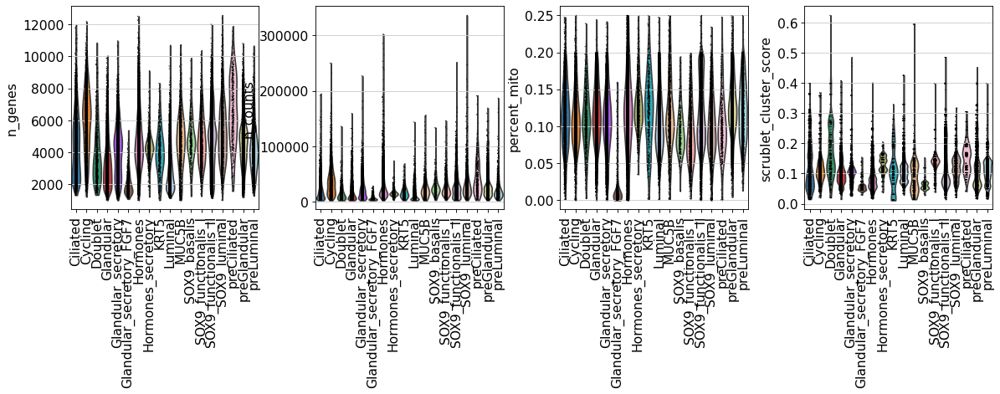

In [82]:
sc.pl.violin(adata, keys= ['n_genes', 'n_counts', 'percent_mito', 'scrublet_cluster_score'], groupby = 'Mareckova_epi_celltype', rotation = 90)

In [83]:
pd.crosstab(adata.obs.genotype_dataset, adata.obs.Mareckova_epi_celltype )

Mareckova_epi_celltype,Ciliated,Cycling,Doublet,Glandular,Glandular_secretory,Glandular_secretory_FGF7,Hormones,Hormones_secretory,KRT5,Luminal,MUC5B,SOX9_basalis,SOX9_functionalis_I,SOX9_functionalis_II,SOX9_luminal,preCiliated,preGlandular,preLuminal
genotype_dataset,,,,,,,,,,,,,,,,,,
Fonseca-Hormones-Endo_Superficial-Fonseca_13,5,0,2,1,95,0,7,0,0,0,0,0,0,0,0,0,0,0
Fonseca-Menopause_Hormones-Endo_Superficial-Fonseca_18,41,0,1,0,0,0,4,0,0,0,0,0,0,2,3,0,0,0
Fonseca-Proliferative-Endo_Superficial-Fonseca_10,6,0,0,0,0,0,4,0,0,0,0,1,0,16,1,1,0,0
Fonseca-Proliferative-Endo_Superficial-Fonseca_16,1,63,0,0,0,0,0,0,0,0,0,0,2,34,1,0,1,0
Fonseca-Proliferative-Endo_Superficial-Fonseca_17,22,2,8,0,0,0,1,0,0,1,0,0,28,86,1,0,0,0
Fonseca-Secretory-Endo_Superficial-Fonseca_11,4,0,1,0,47,0,0,0,0,1,12,0,0,0,1,0,0,0
Fonseca-Secretory-Endo_Superficial-Fonseca_14,23,0,6,26,123,0,7,0,0,2,0,0,0,1,0,0,0,0
GarciaAlonso-Proliferative-Ctrl_Superficial-E3,3,382,0,0,0,0,13,0,34,1,70,2,4,738,100,1,4,2
GarciaAlonso-Proliferative-Ctrl_whole_uterus-A13,288,11,49,0,0,0,43,0,0,0,0,2,0,488,17,23,1,0


In [84]:
adata.write('/nfs/team292/lg18/endometriosis/clustered_objects/cells_epithelial_CLEAN.h5ad')

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


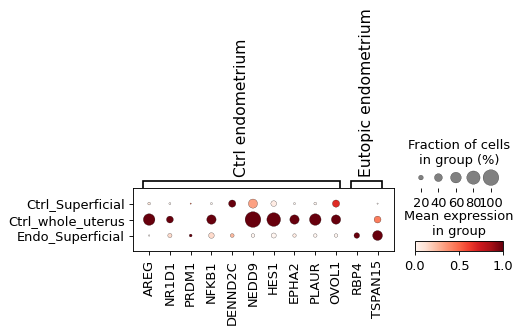

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


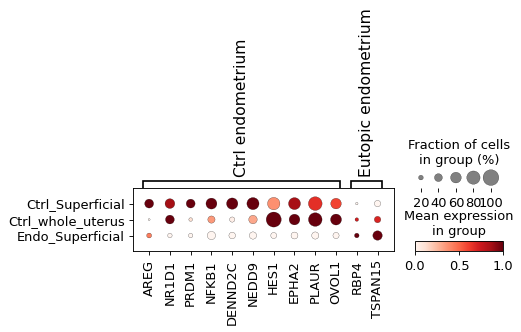

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


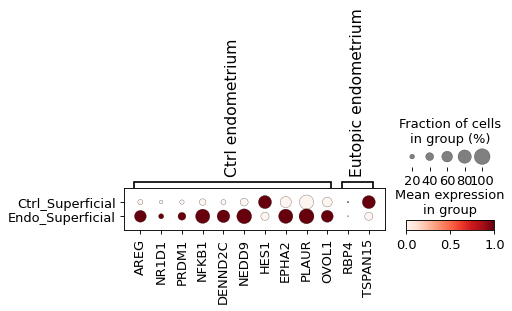

In [85]:
WOI_DEGs_ctrl_endo = {
    'Ctrl endometrium': {'HES1',  'NR1D1', 'PRDM1', 'EPHA2', 'PLAUR', 'NFKB1', 'NEDD9', 'DENND2C', 'OVOL1', 'AREG'},
    'Eutopic endometrium':{"TSPAN15", 'RBP4'}
}

# sc.pl.dotplot(adata, WOI_DEGs_ctrl_endo, groupby='Mareckova_epi_celltype', standard_scale='var', save='DEGs_endometriosis_celltype.pdf')
# X = adata[[ i in ['Mareckova'] for i in adata.obs.dataset ]]
# X = X[[ i not in ['KRT5', 'MUC5B'] for i in X.obs.Mareckova_epi_celltype ]]
# sc.pl.dotplot(X , WOI_DEGs_ctrl_endo, groupby='Mareckova_epi_celltype', standard_scale='var', save='DEGs_endometriosis_celltype.pdf')



# WOI_DEGs_ctrl_endo = {
#     'Ctrl endometrium': {'ADAMTS8',  'RAMP2', 'CBR3', 'XDH'},
#     'Eutopic endometrium':{"SDCBP2", 'STC1', "CXCL14", "S100P", 'SPP1'}
# }
X = adata[[ i in ['Mareckova'] for i in adata.obs.dataset ]]
X = X[[ i in ['Glandular'] for i in X.obs.Mareckova_epi_celltype ]]
sc.pl.dotplot(X , WOI_DEGs_ctrl_endo, groupby='Group', standard_scale='var', save='DEGs_endometriosis_celltype.pdf')


X = adata[[ i in ['Glandular'] for i in adata.obs.Mareckova_epi_celltype ]]
sc.pl.dotplot(X , WOI_DEGs_ctrl_endo, groupby='Group', standard_scale='var', save='DEGs_endometriosis_celltype.pdf')


X = adata[[ i in ['Huang'] for i in adata.obs.dataset ]]
X = X[[ i in ['Glandular'] for i in X.obs.Mareckova_epi_celltype ]]
sc.pl.dotplot(X , WOI_DEGs_ctrl_endo, groupby='Group', standard_scale='var', save='DEGs_endometriosis_celltype.pdf')